In [514]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import numpy as np
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from sklearn.preprocessing import LabelEncoder, OrdinalEncoder
from sklearn.preprocessing import RobustScaler, StandardScaler, MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, root_mean_squared_error, root_mean_squared_log_error
from sklearn.model_selection import train_test_split

In [2]:
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 100)

### Explore Data

In [3]:
house = pd.read_csv("train.csv")
house.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [4]:
house.tail()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1455,1456,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,953,953,GasA,Ex,Y,SBrkr,953,694,0,1647,0,0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1999.0,RFn,2,460,TA,TA,Y,0,40,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,175000
1456,1457,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1978,1988,Gable,CompShg,Plywood,Plywood,Stone,119.0,TA,TA,CBlock,Gd,TA,No,ALQ,790,Rec,163,589,1542,GasA,TA,Y,SBrkr,2073,0,0,2073,1,0,2,0,3,1,TA,7,Min1,2,TA,Attchd,1978.0,Unf,2,500,TA,TA,Y,349,0,0,0,0,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,210000
1457,1458,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,9,1941,2006,Gable,CompShg,CemntBd,CmentBd,NaN,0.0,Ex,Gd,Stone,TA,Gd,No,GLQ,275,Unf,0,877,1152,GasA,Ex,Y,SBrkr,1188,1152,0,2340,0,0,2,0,4,1,Gd,9,Typ,2,Gd,Attchd,1941.0,RFn,1,252,TA,TA,Y,0,60,0,0,0,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1950,1996,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,TA,TA,Mn,GLQ,49,Rec,1029,0,1078,GasA,Gd,Y,FuseA,1078,0,0,1078,1,0,1,0,2,1,Gd,5,Typ,0,NaN,Attchd,1950.0,Unf,1,240,TA,TA,Y,366,0,112,0,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal,142125
1459,1460,20,RL,75.0,9937,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,6,1965,1965,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,CBlock,TA,TA,No,BLQ,830,LwQ,290,136,1256,GasA,Gd,Y,SBrkr,1256,0,0,1256,1,0,1,1,3,1,TA,6,Typ,0,NaN,Attchd,1965.0,Fin,1,276,TA,TA,Y,736,68,0,0,0,0,NaN,NaN,NaN,0,6,2008,WD,Normal,147500


In [5]:
house.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [6]:
house.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [7]:
house.describe(include="object")

,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
count,1460,1460,91,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,588,1460,1460,1460,1423,1423,1422,1423,1422,1460,1460,1460,1459,1460,1460,770,1379,1379,1379,1379,1460,7,281,54,1460,1460
unique,5,2,2,4,4,2,5,3,25,9,8,5,8,6,8,15,16,3,4,5,6,4,4,4,6,6,6,5,2,5,4,7,5,6,3,5,5,3,3,4,4,9,6
top,RL,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,TA,TA,PConc,TA,TA,No,Unf,Unf,GasA,Ex,Y,SBrkr,TA,Typ,Gd,Attchd,Unf,TA,TA,Y,Gd,MnPrv,Shed,WD,Normal
freq,1151,1454,50,925,1311,1459,1052,1382,225,1260,1445,1220,726,1141,1434,515,504,445,906,1282,647,649,1311,953,430,1256,1428,741,1365,1334,735,1360,380,870,605,1311,1326,1340,3,157,49,1267,1198


In [8]:
house.duplicated().sum()

np.int64(0)

In [9]:
house.isna().sum()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage       259
LotArea             0
Street              0
Alley            1369
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType        872
MasVnrArea          8
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           37
BsmtCond           37
BsmtExposure       38
BsmtFinType1       37
BsmtFinSF1          0
BsmtFinType2       38
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          1
1stFlrSF            0
2ndFlrSF            0
LowQualFin

- comments:
    - There is missing values in `LotFrontage`, `Electrical`, `MasVnrArea`
    - Missing values in `Alley` Column indicate that `No alley access`
    - Missing values in `MasVnrType` Column indicate that there is `no masonry veneer` to the house
    - Missing values in `BsmtQual, BsmtCond, BsmtExposure, BsmtFinType1, BsmtFinType2` indicate that there is `no basement`
    - Missing values in `FireplaceQu` indicate that there is `no fireplaces` in the house
    - Missing values in `GarageType, GarageYrBlt, GarageFinish, GarageQual, GarageCond` indicate that `no garage` with the house
    - Missing values in `PoolQC` column tells that `no pool` with house
    - Missing values in `Fence` column indicate that `no fence` around the house
    - Missing values in `MiscFeature` column indicate tht `no miscellaneous feature` with the house

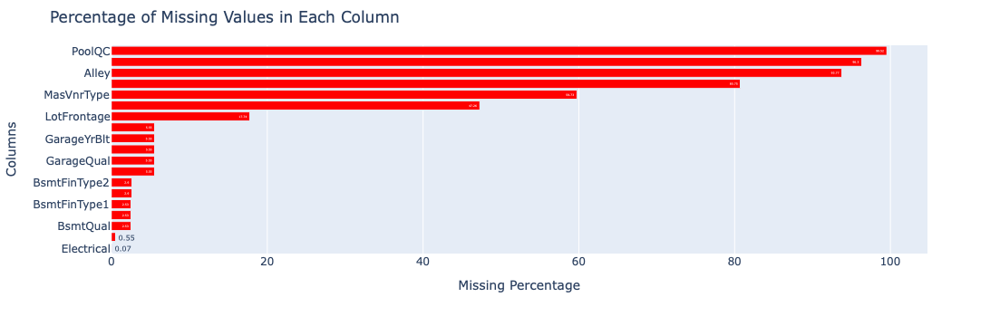

In [10]:
# Calculate the percentage of null values in each column
null_percentages = round(house.isnull().sum(axis=0) / len(house), 4) * 100

# Filter out columns with no missing values
null_percentages = null_percentages[null_percentages > 0]

null_percentages_df = null_percentages.reset_index()
null_percentages_df.columns = ['Column', 'Null Percentage']

fig = px.bar(null_percentages_df.sort_values(by="Null Percentage", ascending=True), 
             y='Column', 
             x='Null Percentage', 
             title='Percentage of Missing Values in Each Column',
             color_discrete_sequence=['red'],
             text_auto=True)

fig.update_layout(yaxis_title='Columns',
                  xaxis_title='Missing Percentage',
                  showlegend=False,
                  margin=dict(t=50, l=100),
                  height=400 + len(null_percentages_df) * 10)

fig.show()

- Insights:
    - Most of the houses has no pools, alleys, fence around them or miscellaneous features (MiscFeature) like tennis court, elevavtor or second garage.
    - Half of the houses has no fireplaces or masonry veneer to their house.
    - only about 20% of the houses has no frontage to the street connect to houses.
    - small number of houses with no garage (6 %) and (3 %) with no basement

### Impute Missing Values

- Filling the missing values according to the data description
    - Missing values in Alley Column indicate that No alley access
    - Missing values in MasVnrType Column indicate that there is no masonry veneer to the house
    - Missing values in BsmtQual, BsmtCond, BsmtExposure, BsmtFinType1, BsmtFinType2 indicate that there is no basement
    - Missing values in FireplaceQu indicate that there is no fireplaces in the house
    - Missing values in GarageType, GarageFinish, GarageQual, GarageCond indicate that no garage with the house
    - Missing values in PoolQC column tells that no pool with house
    - Missing values in Fence column indicate that no fence around the house
    - Missing values in MiscFeature column indicate tht no miscellaneous feature with the house
    - Impute Electrical with mode (most frequent)

In [15]:
impute_with_no = ["Alley", "MasVnrType", "FireplaceQu", "GarageType", "GarageFinish", "GarageQual", "GarageCond",
                  "PoolQC", "Fence", "MiscFeature"]

impute_bsmt = ["BsmtQual", "BsmtCond", "BsmtExposure", "BsmtFinType1", "BsmtFinType2"]

for col in impute_with_no:
    house[col] = house[col].fillna(value="No")

for col in impute_bsmt:
    house[col] = house[col].fillna(value="No Basment")

In [17]:
house["Electrical"].mode()

0    SBrkr
Name: Electrical, dtype: object

In [18]:
house["Electrical"].value_counts()

Electrical
SBrkr    1334
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: count, dtype: int64

In [19]:
house["Electrical"] = house["Electrical"].fillna(value=house["Electrical"].mode()[0])

In [20]:
house["Electrical"].value_counts()

Electrical
SBrkr    1335
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: count, dtype: int64

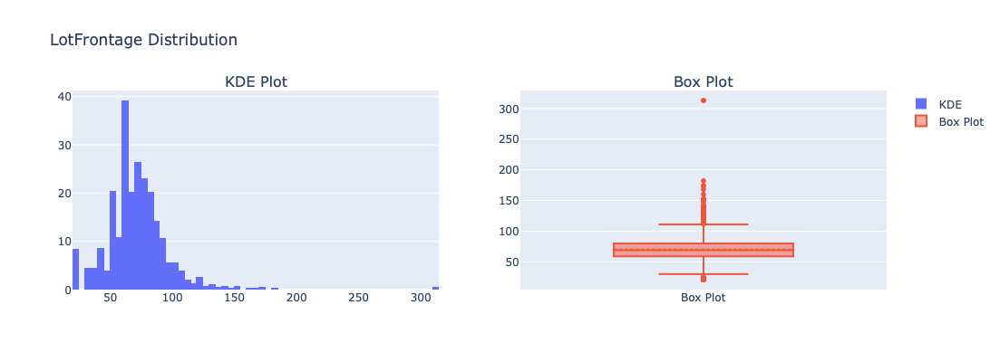

In [21]:
kde_plot = go.Histogram(x=house["LotFrontage"], histnorm='density', name='KDE')
box_plot = go.Box(y=house["LotFrontage"], name='Box Plot', boxmean=True)

fig = make_subplots(rows=1, cols=2, subplot_titles=("KDE Plot", "Box Plot"))

fig.add_trace(kde_plot, row=1, col=1)
fig.add_trace(box_plot, row=1, col=2)

# Update layout for better aesthetics
fig.update_layout(height=400, width=800, title_text="LotFrontage Distribution")

# Show the figure
fig.show()

In [22]:
house[(house["MasVnrType"] =="No") & house["MasVnrArea"].isna()]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
234,235,60,RL,NaN,7851,Pave,No,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,2002,2002,Gable,CompShg,VinylSd,VinylSd,No,NaN,Gd,TA,PConc,Gd,TA,No,GLQ,625,Unf,0,235,860,GasA,Ex,Y,SBrkr,860,1100,0,1960,1,0,2,1,4,1,Gd,8,Typ,2,TA,BuiltIn,2002.0,Fin,2,440,TA,TA,Y,288,48,0,0,0,0,No,No,No,0,5,2010,WD,Normal,216500
529,530,20,RL,NaN,32668,Pave,No,IR1,Lvl,AllPub,CulDSac,Gtl,Crawfor,Norm,Norm,1Fam,1Story,6,3,1957,1975,Hip,CompShg,Wd Sdng,Stone,No,NaN,Gd,TA,PConc,TA,TA,No,Rec,1219,Unf,0,816,2035,GasA,TA,Y,SBrkr,2515,0,0,2515,1,0,3,0,4,2,TA,9,Maj1,2,TA,Attchd,1975.0,RFn,2,484,TA,TA,Y,0,0,200,0,0,0,No,No,No,0,3,2007,WD,Alloca,200624
650,651,60,FV,65.0,8125,Pave,No,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,2Story,7,6,2007,2007,Gable,CompShg,CemntBd,CmentBd,No,NaN,Gd,TA,PConc,Gd,TA,No,Unf,0,Unf,0,813,813,GasA,Ex,Y,SBrkr,822,843,0,1665,0,0,2,1,3,1,Gd,7,Typ,0,No,Attchd,2007.0,RFn,2,562,TA,TA,Y,0,0,0,0,0,0,No,No,No,0,5,2008,WD,Normal,205950
936,937,20,RL,67.0,10083,Pave,No,Reg,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,No,NaN,Gd,TA,PConc,Gd,TA,No,GLQ,833,Unf,0,343,1176,GasA,Ex,Y,SBrkr,1200,0,0,1200,1,0,2,0,2,1,Gd,5,Typ,0,No,Attchd,2003.0,RFn,2,555,TA,TA,Y,0,41,0,0,0,0,No,No,No,0,8,2009,WD,Normal,184900
973,974,20,FV,95.0,11639,Pave,No,Reg,Lvl,AllPub,Corner,Gtl,Somerst,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,CemntBd,CmentBd,No,NaN,Gd,TA,PConc,Gd,TA,No,Unf,0,Unf,0,1428,1428,GasA,Ex,Y,SBrkr,1428,0,0,1428,0,0,2,0,3,1,Gd,6,Typ,0,No,Attchd,2007.0,Fin,2,480,TA,TA,Y,0,120,0,0,0,0,No,No,No,0,12,2008,New,Partial,182000
977,978,120,FV,35.0,4274,Pave,Pave,IR1,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,TwnhsE,1Story,7,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,No,NaN,Gd,TA,PConc,Gd,TA,No,GLQ,1106,Unf,0,135,1241,GasA,Ex,Y,SBrkr,1241,0,0,1241,1,0,1,1,1,1,Gd,4,Typ,0,No,Attchd,2007.0,Fin,2,569,TA,TA,Y,0,116,0,0,0,0,No,No,No,0,11,2007,New,Partial,199900
1243,1244,20,RL,107.0,13891,Pave,No,Reg,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,1Fam,1Story,10,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,No,NaN,Ex,TA,PConc,Ex,Gd,Gd,GLQ,1386,Unf,0,690,2076,GasA,Ex,Y,SBrkr,2076,0,0,2076,1,0,2,1,2,1,Ex,7,Typ,1,Gd,Attchd,2006.0,Fin,3,850,TA,TA,Y,216,229,0,0,0,0,No,No,No,0,9,2006,New,Partial,465000
1278,1279,60,RL,75.0,9473,Pave,No,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,8,5,2002,2002,Gable,CompShg,VinylSd,VinylSd,No,NaN,Gd,TA,PConc,Gd,TA,No,GLQ,804,Unf,0,324,1128,GasA,Ex,Y,SBrkr,1128,903,0,2031,1,0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,2002.0,RFn,2,577,TA,TA,Y,0,211,0,0,0,0,No,No,No,0,3,2008,WD,Normal,237000


- There is missing values in LotFrontage, MasVnrArea, GarageYrBlt
    - GarageYrBlt with 0 as there is no gagrage
    - LotFrontage with median as it contains outliers
    - MasVnrArea with 0 as all missing have No for MasVnrType

#### LotFrontage

In [23]:
house["LotFrontage"].median()

np.float64(69.0)

In [24]:
lot_GrArea = house.groupby("1stFlrSF")["LotFrontage"].median()
lot_GrArea

1stFlrSF
334      50.0
372      70.0
438      60.0
480      50.0
483      21.0
        ...  
2633      NaN
2898      NaN
3138    130.0
3228      NaN
4692    313.0
Name: LotFrontage, Length: 753, dtype: float64

In [25]:
lot_GrArea[(lot_GrArea.index < 1000)].median()

np.float64(60.0)

In [26]:
lot_GrArea[(lot_GrArea.index >= 1000) & (lot_GrArea.index < 2000)].median()

np.float64(75.0)

In [27]:
lot_GrArea[(lot_GrArea.index >= 2000) & (lot_GrArea.index < 3000)].median()

np.float64(91.0)

In [28]:
lot_GrArea[(lot_GrArea.index >= 3000) & (lot_GrArea.index < 4000)].median()

np.float64(130.0)

In [29]:
lot_GrArea[(lot_GrArea.index >= 4000)].median()

np.float64(313.0)

In [30]:
lot_less1000 = lot_GrArea[(lot_GrArea.index < 1000)].median()
lot_greater1000 = lot_GrArea[(lot_GrArea.index >= 1000) & (lot_GrArea.index < 2000)].median()
lot_greater2000 = lot_GrArea[(lot_GrArea.index >= 2000) & (lot_GrArea.index < 3000)].median()
lot_greater3000 = lot_GrArea[(lot_GrArea.index >= 3000) & (lot_GrArea.index < 4000)].median()
lot_greater4000 = lot_GrArea[(lot_GrArea.index >= 4000)].median()

In [31]:
lot_GrArea[lot_GrArea.index < 1000] = lot_GrArea[lot_GrArea.index < 1000].fillna(value=lot_less1000)
lot_GrArea[(lot_GrArea.index >= 1000) & (lot_GrArea.index < 2000)] = lot_GrArea[(lot_GrArea.index >= 1000) & (lot_GrArea.index < 2000)].fillna(value=lot_greater1000)
lot_GrArea[(lot_GrArea.index >= 2000) & (lot_GrArea.index < 3000)] = lot_GrArea[(lot_GrArea.index >= 2000) & (lot_GrArea.index < 3000)].fillna(value=lot_greater2000)
lot_GrArea[(lot_GrArea.index >= 3000) & (lot_GrArea.index < 4000)] = lot_GrArea[(lot_GrArea.index >= 3000) & (lot_GrArea.index < 4000)].fillna(value=lot_greater3000)
lot_GrArea[(lot_GrArea.index >= 4000)] = lot_GrArea[(lot_GrArea.index >= 4000)].fillna(value=lot_greater4000)

In [32]:
# Function to apply the appropriate median value based on 1stFlrSF
def fill_lot_frontage(row):
    if pd.isna(row['LotFrontage']):
        if row['1stFlrSF'] < 1000:
            return lot_less1000
        elif 1000 <= row['1stFlrSF'] < 2000:
            return lot_greater1000
        elif 2000 <= row['1stFlrSF'] < 3000:
            return lot_greater2000
        elif 3000 <= row['1stFlrSF'] < 4000:
            return lot_greater3000
        elif row['1stFlrSF'] >= 4000:
            return lot_greater4000
    else:
        return row['LotFrontage']

# Apply the function to the 'LotFrontage' column to fill missing values
house['LotFrontage'] = house.apply(fill_lot_frontage, axis=1)

In [36]:
missing_dic = {"GarageYrBlt":0,
               "MasVnrArea":0}

for key, values in missing_dic.items():
    house[key] = house[key].fillna(value=values)

In [37]:
num_cols = house.select_dtypes(exclude="object")
cat_cols = house.select_dtypes(include="object")

In [38]:
num_cols.columns

Index(['Id', 'MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

In [39]:
cat_cols.columns

Index(['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual',
       'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual',
       'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature',
       'SaleType', 'SaleCondition'],
      dtype='object')

- 'MSSubClass'
- 'LotFrontage', 'LotArea',
- 'OverallQual','OverallCond',
- 'YearBuilt', 'YearRemodAdd','MoSold', 'YrSold','GarageYrBlt' -> replace with house age and remod age
- 'MasVnrArea',
- 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF'-> replace with 'BsmtUnfSF', 'TotalBsmtSF'
- '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea'->
- 'BsmtFullBath', 'BsmtHalfBath', 'FullBath','HalfBath'->
- 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd'->
- 'Fireplaces'
- 'GarageCars', 'GarageArea'->
- 'WoodDeckSF'->
- 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch'->
- 'PoolArea'
- 'MiscVal'

### Outliers

No. of IQR outliers in 'Id': 0
Percentage of outliers in 'Id': 0.00%
-----------------------------------------------------------------
No. of IQR outliers in 'MSSubClass': 103
Percentage of outliers in 'MSSubClass': 7.05%
-----------------------------------------------------------------
No. of IQR outliers in 'LotFrontage': 107
Percentage of outliers in 'LotFrontage': 7.33%
-----------------------------------------------------------------
No. of IQR outliers in 'LotArea': 69
Percentage of outliers in 'LotArea': 4.73%
-----------------------------------------------------------------
No. of IQR outliers in 'OverallQual': 2
Percentage of outliers in 'OverallQual': 0.14%
-----------------------------------------------------------------
No. of IQR outliers in 'OverallCond': 125
Percentage of outliers in 'OverallCond': 8.56%
-----------------------------------------------------------------
No. of IQR outliers in 'YearBuilt': 7
Percentage of outliers in 'YearBuilt': 0.48%
--------------------

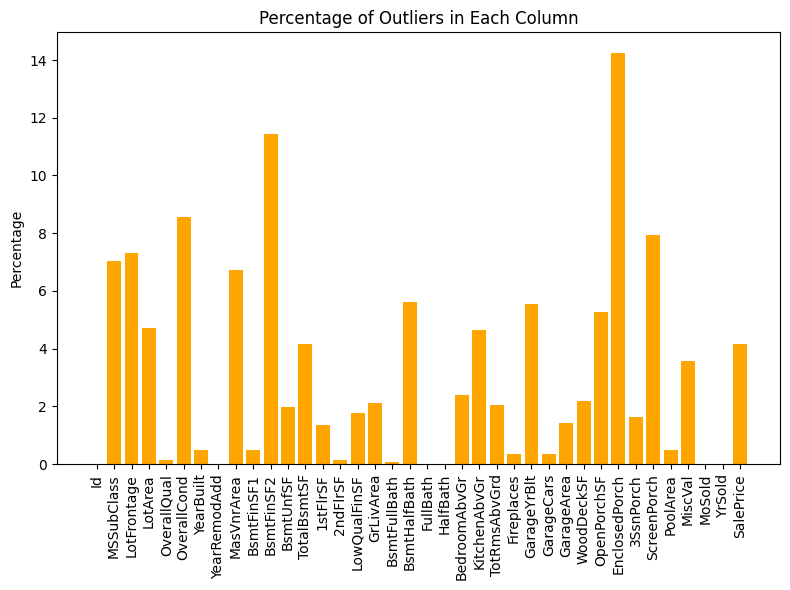

In [41]:
def analyze_visualize_outliers(data, num_columns, plot_type="both"):
    """
    Analyzes and visualizes outliers in numerical columns of a DataFrame.

    Args:
        data (pd.DataFrame): The DataFrame containing the data.
        num_columns (list): A list of numerical column names to analyze.

    Returns:
        dict: A dictionary containing outliers, their counts and percentages for each column.
    """

    outlier_data = {}
    for col in num_columns:
        data_column = data[col]
        Q1 = data_column.quantile(0.25)
        Q3 = data_column.quantile(0.75)
        IQR = Q3 - Q1

        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        outliers = data_column[(data_column < lower_bound) | (data_column > upper_bound)]
        outlier_counts = len(outliers)
        outlier_percentages = (outlier_counts / len(data_column)) * 100

        outlier_data[col] = {
            'count': outlier_counts,
            'percentage': outlier_percentages,
            'outliers': outliers.tolist()
        }

        print(f"No. of IQR outliers in '{col}': {outlier_counts}")
        print(f"Percentage of outliers in '{col}': {outlier_percentages:.2f}%")
        print("-----------------------------------------------------------------")

    # Visualization based on plot_type argument
    if plot_type == "counts":
        fig, ax = plt.subplots(figsize=(8, 6))
        ax.bar(outlier_data.keys(), [v['count'] for v in outlier_data.values()], color='red')
        ax.set_title('Number of Outliers in Each Column')
        ax.set_ylabel('Count')
        ax.set_xticks(list(outlier_data.keys())) 
        ax.set_xticklabels(list(outlier_data.keys()), rotation=90)  
            
        plt.tight_layout()
        plt.show()

    elif plot_type == "percentages":
        fig, ax = plt.subplots(figsize=(8, 6))
        ax.bar(outlier_data.keys(), [v['percentage'] for v in outlier_data.values()], color='orange')
        ax.set_title('Percentage of Outliers in Each Column')
        ax.set_ylabel('Percentage')
        ax.set_xticks(list(outlier_data.keys()))  
        ax.set_xticklabels(list(outlier_data.keys()), rotation=90)  
            
        plt.tight_layout()
        plt.show()

    elif plot_type == "both":
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

        # Plot outlier counts
        ax1.bar(outlier_data.keys(), [v['count'] for v in outlier_data.values()], color='red')
        ax1.set_title('Number of Outliers in Each Column')
        ax1.set_ylabel('Count')
        ax1.set_xticks(list(outlier_data.keys()))  
        ax1.set_xticklabels(list(outlier_data.keys()), rotation=90)  


        # Plot outlier percentages
        ax2.bar(outlier_data.keys(), [v['percentage'] for v in outlier_data.values()], color='orange')
        ax2.set_title('Percentage of Outliers in Each Column')
        ax2.set_ylabel('Percentage')
        ax2.set_xticks(list(outlier_data.keys()))  
        ax2.set_xticklabels(list(outlier_data.keys()), rotation=90)


        plt.tight_layout()
        plt.show()

    else:
        print(f"Invalid plot_type: {plot_type}. Valid options are 'counts', 'percentages', or 'both'.")


    return outlier_data

outlier_results = analyze_visualize_outliers(house, num_cols, plot_type="percentages")

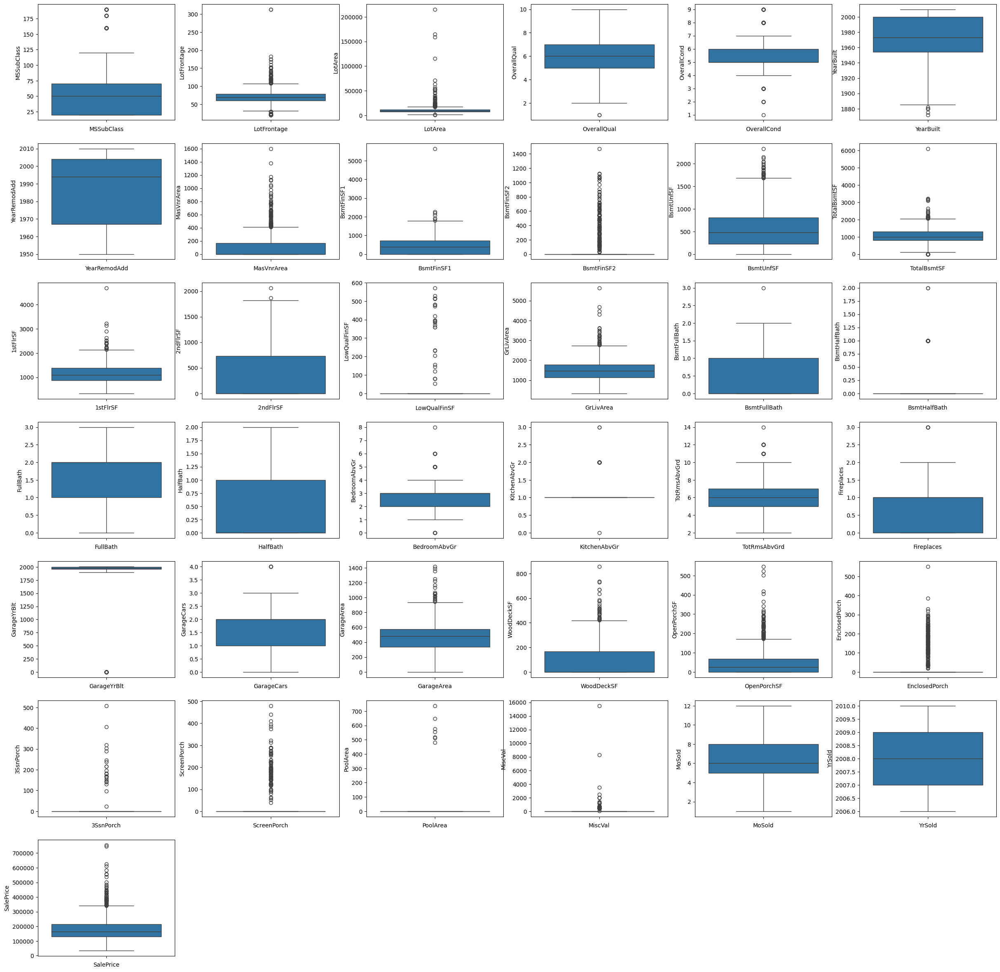

In [42]:
fig = plt.figure(figsize=(30,30))

counter = 0

for col in num_cols.columns[1:]:
    sub = fig.add_subplot(7,6,counter+1)
    g = sns.boxplot(data=house[col])
    plt.xlabel(col)
    counter = counter + 1

### EDA

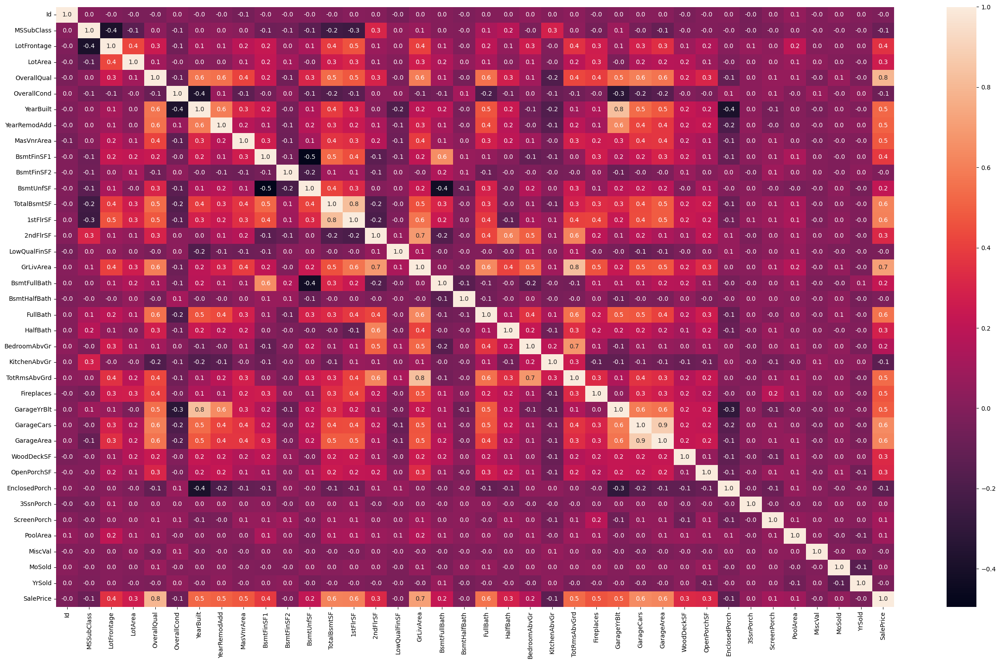

<Figure size 640x480 with 0 Axes>

In [19]:
plt.figure(figsize=(25,15))
sns.heatmap(house.select_dtypes(exclude="object").corr(), annot=True, fmt="1.1f")
plt.tight_layout()
plt.figure();

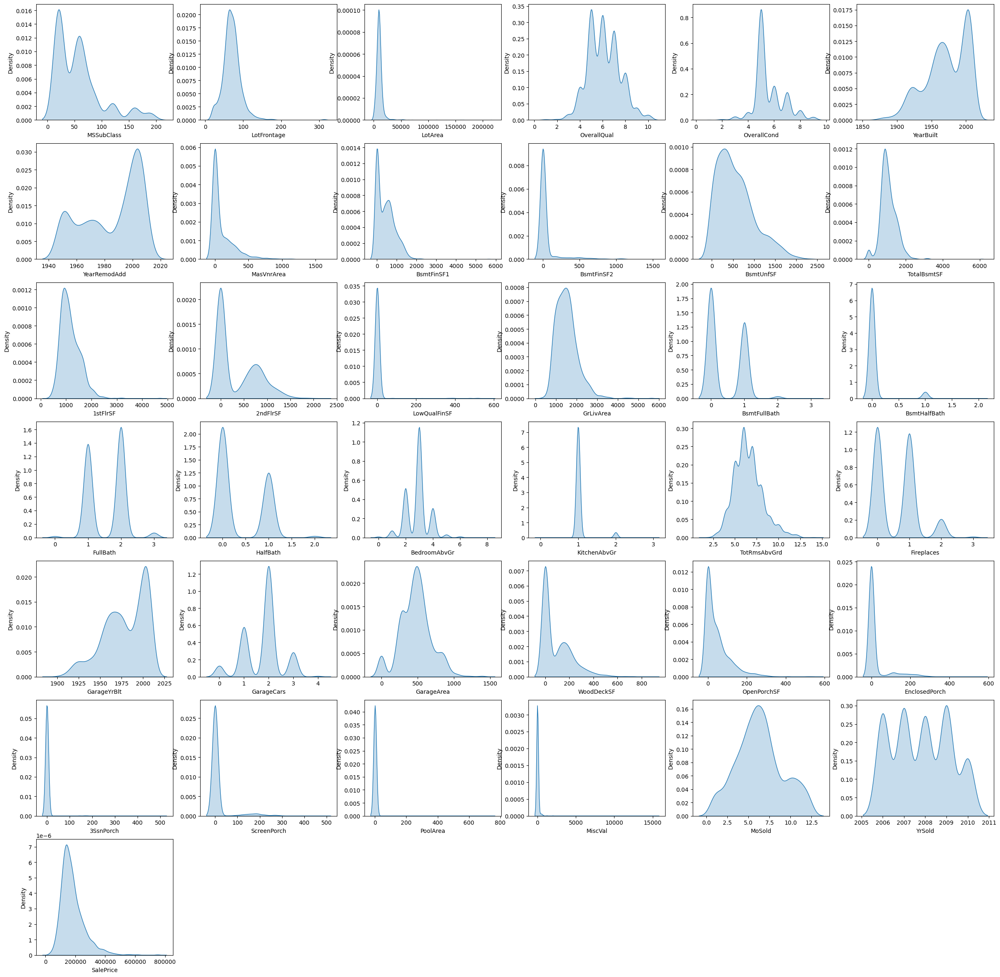

In [21]:
fig = plt.figure(figsize=(30,30))

counter = 0

for col in num_cols.columns[1:]:
    sub = fig.add_subplot(7,6,counter+1)
    g = sns.kdeplot(x=col,data=house,fill=True)
    plt.xticks()
    counter = counter + 1

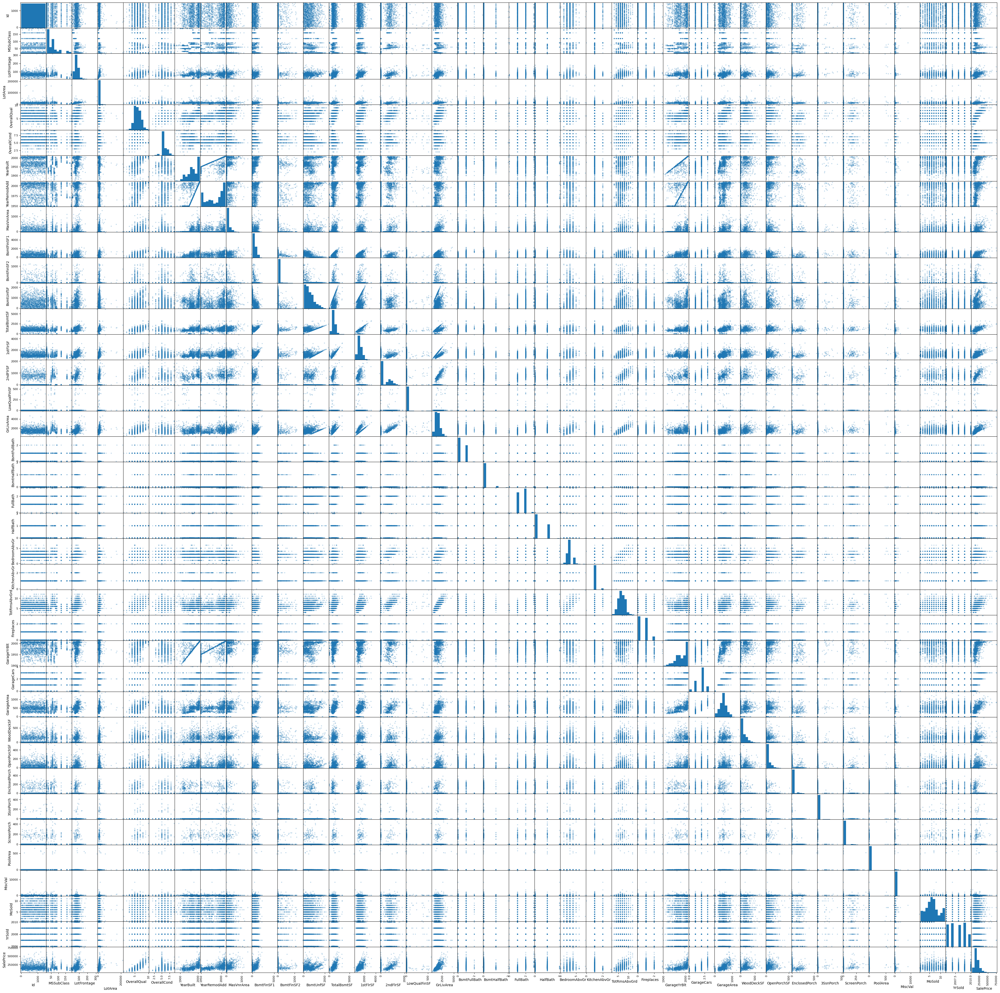

In [103]:
pd.plotting.scatter_matrix(house, alpha=0.3, figsize=(50,50))
plt.xticks(rotation = 90)
plt.show();

In [101]:
plt.figure(figsize = (50,50))
sns.pairplot(num_cols) # diag_kind='kde', corner=True
plt.show();

<Figure size 5000x5000 with 0 Axes>

In [100]:
plt.figure(figsize = (50,50))
sns.pairplot(house)
plt.show();

<Figure size 5000x5000 with 0 Axes>

## Numerical Columns

### Missing values

In [43]:
num_cols.isna().sum()

Id               0
MSSubClass       0
LotFrontage      0
LotArea          0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
MasVnrArea       0
BsmtFinSF1       0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
TotRmsAbvGrd     0
Fireplaces       0
GarageYrBlt      0
GarageCars       0
GarageArea       0
WoodDeckSF       0
OpenPorchSF      0
EnclosedPorch    0
3SsnPorch        0
ScreenPorch      0
PoolArea         0
MiscVal          0
MoSold           0
YrSold           0
SalePrice        0
dtype: int64

### Columns: 'Id', 'MSSubClass'

In [669]:
house_cleaned = house.copy()

In [670]:
house_cleaned = house_cleaned.drop(columns=["Id"])

In [671]:
house_cleaned["MSSubClass"].value_counts()

MSSubClass
20     536
60     299
50     144
120     87
30      69
160     63
70      60
80      58
90      52
190     30
85      20
75      16
45      12
180     10
40       4
Name: count, dtype: int64

In [672]:
unique_values = house_cleaned["MSSubClass"].unique()

fig = px.histogram(x=house_cleaned["MSSubClass"], nbins=90, text_auto=True)

fig.update_layout(yaxis_title='Count',
                  xaxis_title='MSSubClass',
                  showlegend=False,
                  xaxis=dict(tickvals=unique_values))

fig.show()

- according to data description, we have columns that may have correlation with this column which is `HouseStyle`, `BldgType`, `YearBuilt`, so we can drop this column later.

In [673]:
subclass_price = house_cleaned.groupby("MSSubClass")["SalePrice"].mean()
subclass_price_df = subclass_price.reset_index()

fig = px.bar(x=subclass_price_df["MSSubClass"], y =subclass_price_df["SalePrice"], text_auto=True)

fig.update_layout(yaxis_title='Count',
                  xaxis_title='MSSubClass',
                  showlegend=False,
                  xaxis=dict(tickvals=unique_values))

fig.show()

- Insights:
- top-4 avg prices for houses with the following styles:
    - 60	2-STORY 1946 & NEWER
    - 120	1-STORY PUD (Planned Unit Development) - 1946 & NEWER
    - 75	2-1/2 STORY ALL AGES
    - 20	1-STORY 1946 & NEWER ALL STYLES

so houses with built from 1946 & NEWER has avg high prices

In [674]:
house_cleaned = house_cleaned.drop(columns=["MSSubClass"])

### Columns: 'LotFrontage', 'LotArea'

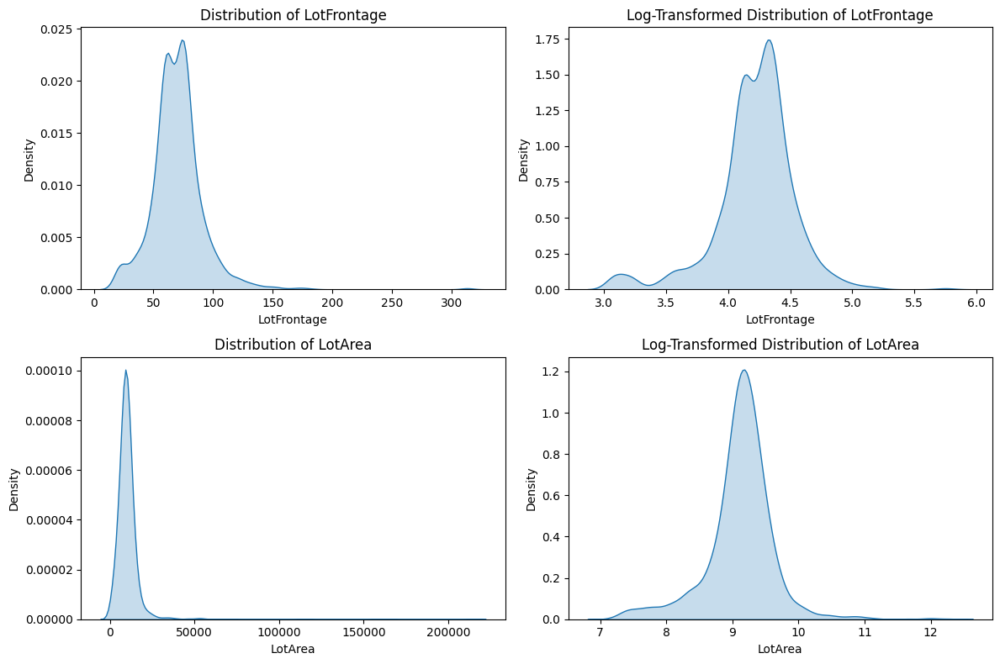

In [675]:
fig = plt.figure(figsize=(12,8))

counter = 0

for i in ["LotFrontage", "LotArea"]:
    # Original data plot
    sub = fig.add_subplot(2, 2, counter + 1)
    g = sns.kdeplot(x=i, data=house_cleaned, fill=True)
    plt.title(f'Distribution of {i}')
    plt.xticks()
    
    # Log-transformed data plot
    sub = fig.add_subplot(2, 2, counter + 2)
    log_col = np.log1p(house_cleaned[i])  # Use np.log1p for log(1 + x)
    g = sns.kdeplot(x=log_col, fill=True)
    plt.title(f'Log-Transformed Distribution of {i}')
    plt.xticks()

    counter = counter + 2

plt.tight_layout()
plt.show()

In [676]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Create subplots
fig = make_subplots(rows=3, cols=1, 
                    subplot_titles=(
                        'LotFrontage vs LotArea',
                        'LotArea vs SalePrice',
                        'LotFrontage vs SalePrice'
                    ))

# First scatter plot (LotFrontage vs LotArea)
scatter1 = px.scatter(x=house_cleaned["LotFrontage"], 
                      y=house_cleaned["LotArea"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline1 = px.scatter(x=house_cleaned["LotFrontage"], 
                        y=house_cleaned["LotArea"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter1, row=1, col=1)
fig.add_trace(trendline1, row=1, col=1)

# Second scatter plot (LotArea vs SalePrice)
scatter2 = px.scatter(y=house_cleaned["SalePrice"], 
                      x=house_cleaned["LotArea"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline2 = px.scatter(y=house_cleaned["SalePrice"], 
                        x=house_cleaned["LotArea"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter2, row=2, col=1)
fig.add_trace(trendline2, row=2, col=1)

# Third scatter plot (LotFrontage vs SalePrice)
scatter3 = px.scatter(y=house_cleaned["SalePrice"], 
                      x=house_cleaned["LotFrontage"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline3 = px.scatter(y=house_cleaned["SalePrice"], 
                        x=house_cleaned["LotFrontage"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter3, row=3, col=1)
fig.add_trace(trendline3, row=3, col=1)

# Update layout for the entire figure
fig.update_layout(height=900, 
                  width=1000, 
                  title_text="Combined Scatter Plots",
                  showlegend=False)

# Update individual subplot axes titles
fig.update_xaxes(title_text="LotFrontage", row=1, col=1)
fig.update_yaxes(title_text="LotArea", row=1, col=1)

fig.update_xaxes(title_text="LotArea", row=2, col=1)
fig.update_yaxes(title_text="SalePrice", row=2, col=1)

fig.update_xaxes(title_text="LotFrontage", row=3, col=1)
fig.update_yaxes(title_text="SalePrice", row=3, col=1)

fig.show()

In [677]:
house_cleaned = house_cleaned.drop(columns=["LotArea"])

### Columns: 'OverallQual', 'OverallCond'

In [678]:
house_cleaned["OverallQual"].value_counts()

OverallQual
5     397
6     374
7     319
8     168
4     116
9      43
3      20
10     18
2       3
1       2
Name: count, dtype: int64

In [679]:
house_cleaned["OverallCond"].value_counts()

OverallCond
5    821
6    252
7    205
8     72
4     57
3     25
9     22
2      5
1      1
Name: count, dtype: int64

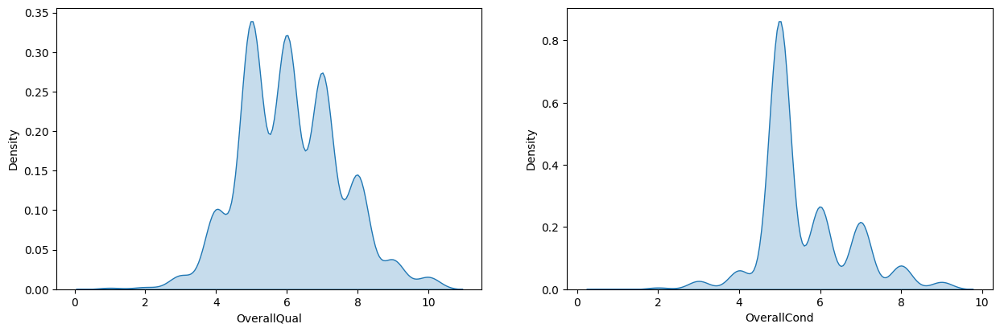

In [680]:
fig = plt.figure(figsize=(15,10))

counter = 0

for i in ["OverallQual", "OverallCond"]:
        sub = fig.add_subplot(2,2,counter+1)
        g = sns.kdeplot(x=i,data=house_cleaned,fill=True)
        plt.xticks()
        counter = counter + 1

In [681]:
unique_values = house_cleaned["OverallQual"].unique()

fig = px.histogram(x=house_cleaned["OverallQual"], nbins=20, text_auto=True)

fig.update_layout(yaxis_title='Count',
                  xaxis_title='OverallQual',
                  showlegend=False,
                  xaxis=dict(tickvals=unique_values))

fig.show()

In [682]:
subclass_price = house_cleaned.groupby("OverallQual")["SalePrice"].mean()
subclass_price_df = subclass_price.reset_index()

fig = px.bar(x=subclass_price_df["OverallQual"], y =subclass_price_df["SalePrice"], text_auto=True)

fig.update_layout(yaxis_title='Count',
                  xaxis_title='OverallQual',
                  showlegend=False,
                  xaxis=dict(tickvals=unique_values))

fig.show()

In [683]:
subclass_price = house_cleaned.groupby("OverallCond")["SalePrice"].mean()
subclass_price_df = subclass_price.reset_index()

fig = px.bar(x=subclass_price_df["OverallCond"], y =subclass_price_df["SalePrice"], text_auto=True)

fig.update_layout(yaxis_title='Count',
                  xaxis_title='OverallCond',
                  showlegend=False,
                  xaxis=dict(tickvals=unique_values))

fig.show()

In [684]:
house_cleaned = house_cleaned.drop(columns=["OverallCond"])

In [685]:
house_cleaned['YearBuilt_Binned'] = pd.cut(house_cleaned['YearBuilt'], bins=[1870, 1900, 1920, 1940, 1960, 1980, 2000, 2020],
                                   labels=['<1900', '1900-1920', '1920-1940', '1940-1960', '1960-1980', '1980-2000', '2000+'])

# Aggregate the data by YearBuilt_Binned and OverallQual
aggregated_data = house_cleaned.groupby(['YearBuilt_Binned', 'OverallQual'], observed=True)['SalePrice'].mean().reset_index()

# Filtered data for certain levels of OverallQual
filtered_data = aggregated_data[aggregated_data['OverallQual'].isin([5, 6, 7, 8])]

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=2, cols=1, subplot_titles=(
    'Interaction between Overall Quality and Year Built on Sale Price (Binned Years)',
    'Rate of 5,6,7 Overall Quality and Year Built on Sale Price'
))

# Add the first line plot (unfiltered data)
for quality in aggregated_data['OverallQual'].unique():
    filtered = aggregated_data[aggregated_data['OverallQual'] == quality]
    fig.add_trace(
        go.Scatter(x=filtered['YearBuilt_Binned'], y=filtered['SalePrice'], mode='lines', name=f'{quality}'),
        row=1, col=1
    )

# Add the second line plot (filtered data)
for quality in filtered_data['OverallQual'].unique():
    filtered = filtered_data[filtered_data['OverallQual'] == quality]
    fig.add_trace(
        go.Scatter(x=filtered['YearBuilt_Binned'], y=filtered['SalePrice'], mode='lines', showlegend=False),
        row=2, col=1
    )

# Update layout for the entire figure
fig.update_layout(height=800, width=1100,
    title_text='Relation Overall Quality and Year Built on Sale Price',
    xaxis_title='Year Built',
    yaxis_title='Average Sale Price',
    xaxis2_title='Year Built',
    yaxis2_title='Average Sale Price',
    legend_title_text='Overall Quality',
)

# Show the figure
fig.show()

### Columns: 'MoSold', 'YrSold', 'GarageYrBlt', 'YearBuilt', 'YearRemodAdd'

In [686]:
house_cleaned["HomeAge"] = house_cleaned["YrSold"] - house_cleaned["YearBuilt"]
house_cleaned["RemodAge"] = house_cleaned["YrSold"] - house_cleaned["YearRemodAdd"]

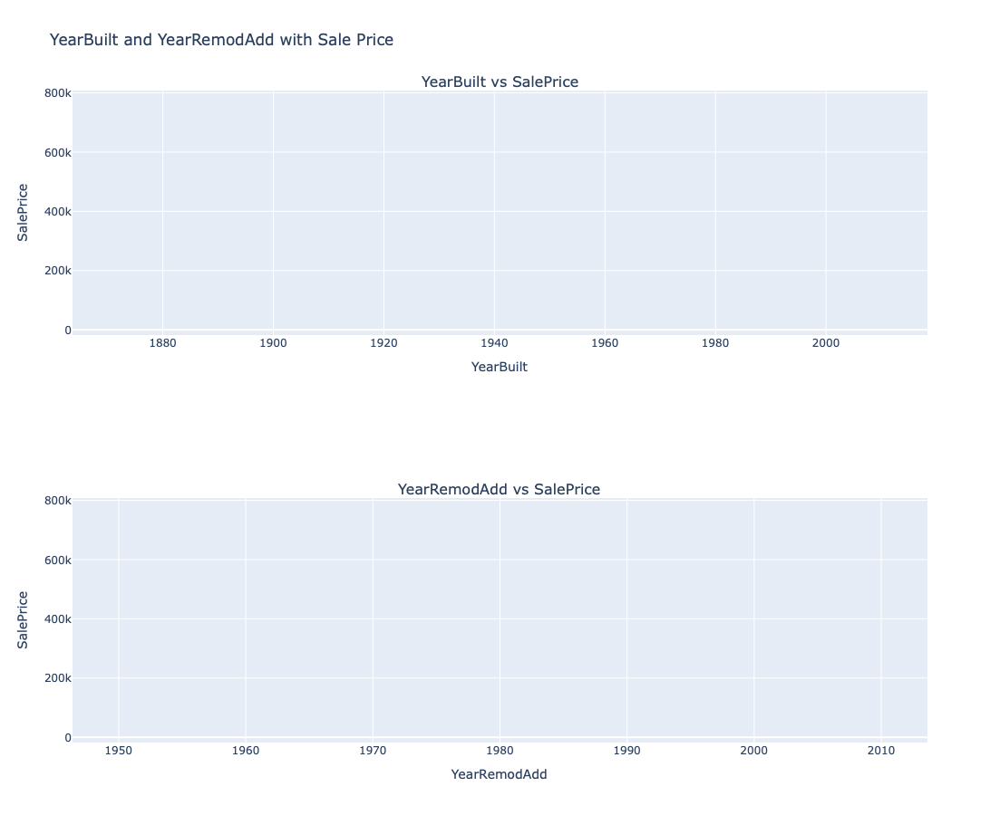

In [687]:
# Create subplots
fig = make_subplots(rows=2, cols=1, 
                    subplot_titles=(
                        'YearBuilt vs SalePrice',
                        'YearRemodAdd vs SalePrice',
                        # 'GarageYrBlt vs SalePrice',
                    ))

# First scatter plot (YearBuilt vs SalePrice)
scatter1 = px.scatter(x=house_cleaned["YearBuilt"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline1 = px.scatter(x=house_cleaned["YearBuilt"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter1, row=1, col=1)
fig.add_trace(trendline1, row=1, col=1)

# Second scatter plot (YearRemodAdd vs SalePrice)
scatter2 = px.scatter(x=house_cleaned["YearRemodAdd"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline2 = px.scatter(x=house_cleaned["YearRemodAdd"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter2, row=2, col=1)
fig.add_trace(trendline2, row=2, col=1)

# Third scatter plot (GarageYrBlt vs SalePrice)
# scatter3 = px.scatter(x=house_cleaned["GarageYrBlt"],
#                       y=house_cleaned["SalePrice"],
#                       trendline='ols',
#                       trendline_color_override="red").data[0]

# trendline3 = px.scatter(x=house_cleaned["GarageYrBlt"],
#                         y=house_cleaned["SalePrice"], 
#                         trendline='ols',
#                         trendline_color_override="red").data[1]

# fig.add_trace(scatter3, row=3, col=1)
# fig.add_trace(trendline3, row=3, col=1)

# Update layout for the entire figure
fig.update_layout(height=900, 
                  width=1000, 
                  title_text="YearBuilt and YearRemodAdd with Sale Price",
                  showlegend=False)

# Update individual subplot axes titles
fig.update_xaxes(title_text="YearBuilt", row=1, col=1)
fig.update_yaxes(title_text="SalePrice", row=1, col=1)

fig.update_xaxes(title_text="YearRemodAdd", row=2, col=1)
fig.update_yaxes(title_text="SalePrice", row=2, col=1)

# fig.update_xaxes(title_text="GarageYrBlt", row=3, col=1)
# fig.update_yaxes(title_text="SalePrice", row=3, col=1)

fig.show()

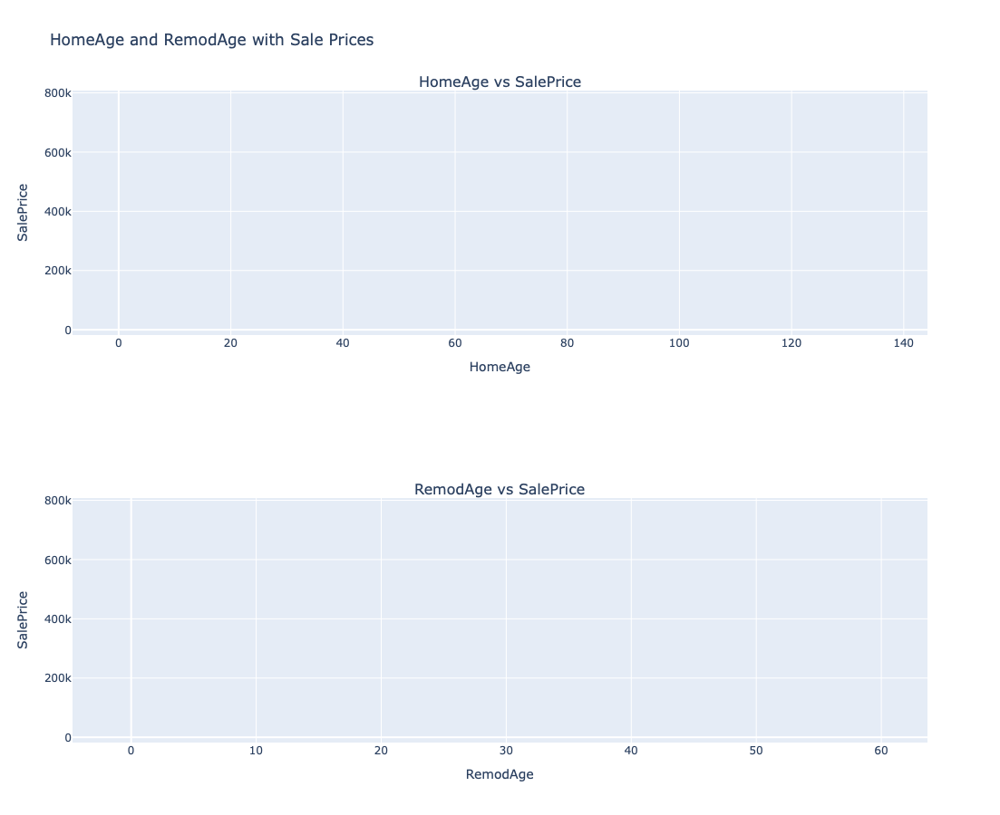

In [688]:
# Create subplots
fig = make_subplots(rows=2, cols=1, 
                    subplot_titles=(
                        'HomeAge vs SalePrice',
                        'RemodAge vs SalePrice',
                    ))

# First scatter plot (LotFrontage vs LotArea)
scatter1 = px.scatter(x=house_cleaned["HomeAge"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline1 = px.scatter(x=house_cleaned["HomeAge"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter1, row=1, col=1)
fig.add_trace(trendline1, row=1, col=1)

# Second scatter plot (LotArea vs SalePrice)
scatter2 = px.scatter(x=house_cleaned["RemodAge"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline2 = px.scatter(x=house_cleaned["RemodAge"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter2, row=2, col=1)
fig.add_trace(trendline2, row=2, col=1)


# Update layout for the entire figure
fig.update_layout(height=900, 
                  width=1000, 
                  title_text="HomeAge and RemodAge with Sale Prices",
                  showlegend=False)

# Update individual subplot axes titles
fig.update_xaxes(title_text="HomeAge", row=1, col=1)
fig.update_yaxes(title_text="SalePrice", row=1, col=1)

fig.update_xaxes(title_text="RemodAge", row=2, col=1)
fig.update_yaxes(title_text="SalePrice", row=2, col=1)

fig.show()

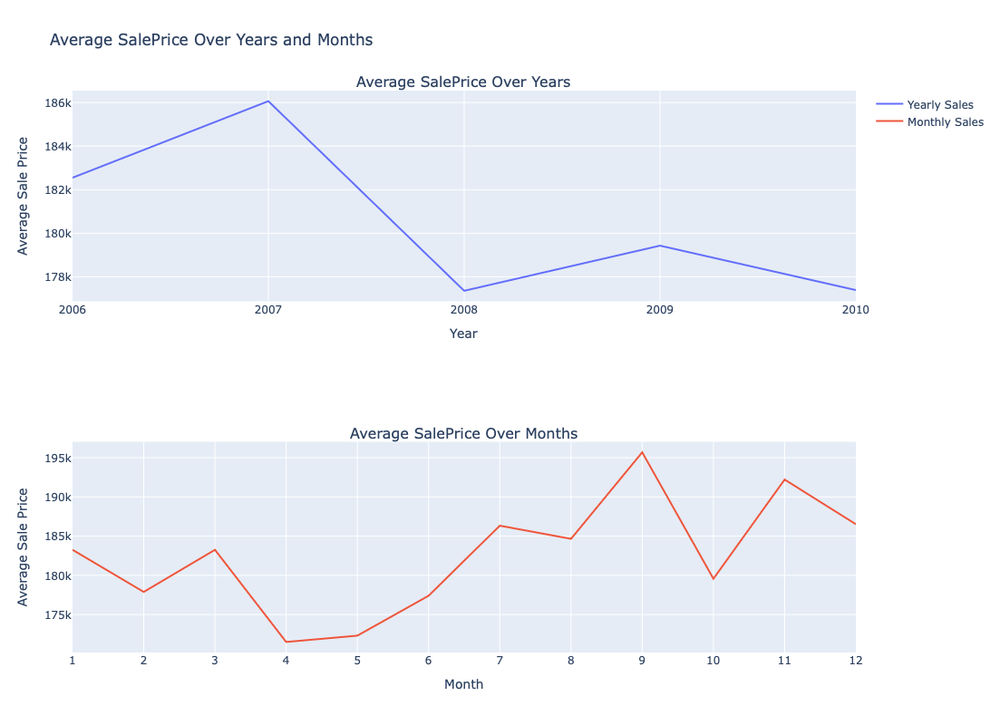

In [689]:
# Group by YrSold and calculate the mean SalePrice
yearly_sales = house_cleaned.groupby('YrSold')['SalePrice'].mean().reset_index()

# Group by MoSold and calculate the mean SalePrice
monthly_sales = house_cleaned.groupby('MoSold')['SalePrice'].mean().reset_index()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=2, cols=1, subplot_titles=('Average SalePrice Over Years', 'Average SalePrice Over Months'))

# Add the first line plot to the first subplot
fig.add_trace(
    go.Scatter(x=yearly_sales['YrSold'], y=yearly_sales['SalePrice'], mode='lines', name='Yearly Sales'),
    row=1, col=1
)

# Add the second line plot to the second subplot
fig.add_trace(
    go.Scatter(x=monthly_sales['MoSold'], y=monthly_sales['SalePrice'], mode='lines', name='Monthly Sales'),
    row=2, col=1
)

# Update layout for the entire figure
fig.update_layout(title_text='Average SalePrice Over Years and Months',
                  height=800, width=1100,
                  xaxis_title='Year',
                  xaxis2_title='Month',
                  yaxis_title='Average Sale Price',
                  yaxis2_title='Average Sale Price',
                  xaxis=dict(tickvals=list(house_cleaned['YrSold'].unique())),
                  xaxis2=dict(tickvals=list(house_cleaned['MoSold'].unique())))

# Show the figure
fig.show()

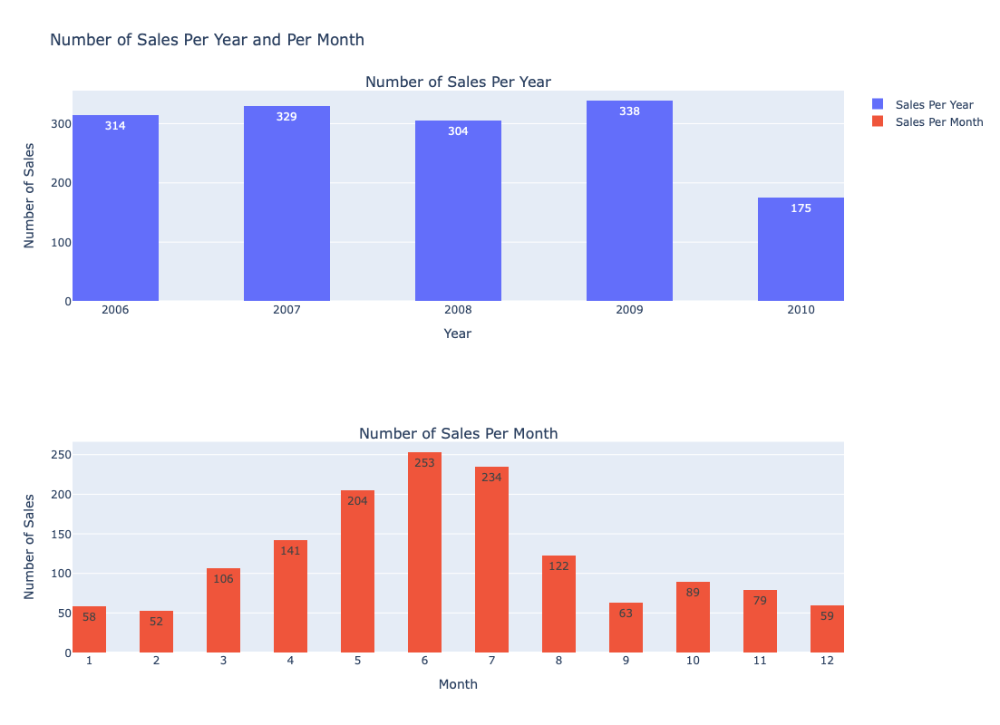

In [690]:
# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=2, cols=1, subplot_titles=('Number of Sales Per Year', 'Number of Sales Per Month'))

# Add histogram for number of sales per year
fig.add_trace(
    go.Histogram(x=house_cleaned['YrSold'], nbinsx=10, texttemplate='%{y}', name='Sales Per Year'),
    row=1, col=1
)

# Add histogram for number of sales per month
fig.add_trace(
    go.Histogram(x=house_cleaned['MoSold'], nbinsx=30, texttemplate= '%{y}', name='Sales Per Month'),
    row=2, col=1
)

# Update layout for the entire figure
fig.update_layout(height=800, width=1000,
    title_text='Number of Sales Per Year and Per Month',
    xaxis_title='Year',
    yaxis_title='Number of Sales',
    xaxis2_title='Month',
    yaxis2_title='Number of Sales',
    xaxis=dict(tickvals=list(house_cleaned['YrSold'].unique())),  # Custom x-axis for Year
    xaxis2=dict(tickvals=list(house_cleaned['MoSold'].unique()))  # Custom x-axis for Month
)

# Show the figure
fig.show()

- Insights:
    - top months with avg sales were: September and November
    - top years with avg sales were: 2007
    - top-3 months for number of sales are in order: June, July and May
    - top years for number of sales were: 2009, 2007 and 2006

In [691]:
house_cleaned = house_cleaned.drop(columns=['MoSold', 'YrSold', 'YearBuilt', 'YearRemodAdd'])

In [692]:
# house_cleaned['HomeAge_log'] = np.log10(house_cleaned['HomeAge']+2)
# house_cleaned['SalePrice_log'] = np.log10(house_cleaned['SalePrice'])
# house_cleaned['RemodAge_log'] = np.log10(house_cleaned['RemodAge']+2)

In [693]:
# house_cleaned[["HomeAge", "RemodAge", "SalePrice","SalePrice_log", "HomeAge_log", "RemodAge_log"]].corr()

### Columns: 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF'

In [694]:
house["MasVnrArea"].value_counts()

MasVnrArea
0.0      869
180.0      8
72.0       8
108.0      8
120.0      7
        ... 
562.0      1
89.0       1
921.0      1
762.0      1
119.0      1
Name: count, Length: 327, dtype: int64

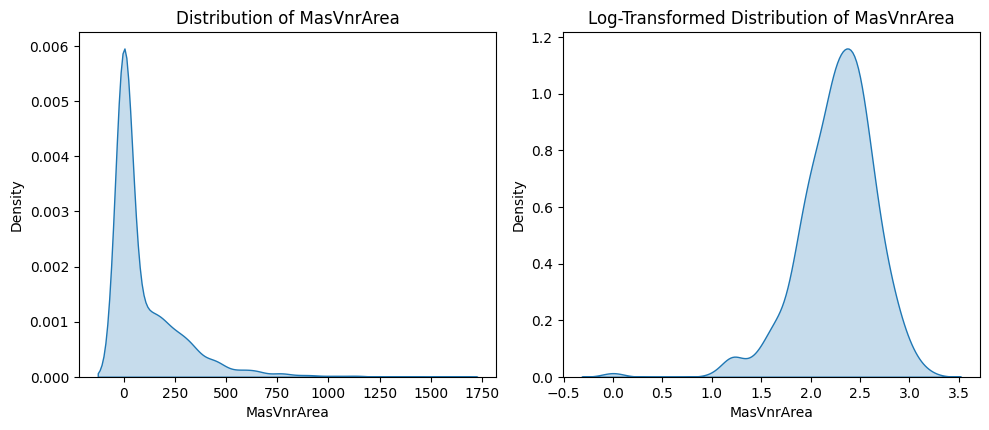

In [695]:
import warnings
warnings.filterwarnings("ignore")

fig = plt.figure(figsize=(10,8))

counter = 0

for i in ["MasVnrArea"]:
    # Original data plot
    sub = fig.add_subplot(2, 2, counter + 1)
    g = sns.kdeplot(x=i, data=house_cleaned, fill=True)
    plt.title(f'Distribution of {i}')
    plt.xticks()
    
    # Log-transformed data plot
    sub = fig.add_subplot(2, 2, counter + 2)
    log_col = np.log10(house_cleaned[i])  # Use np.log1p for log(1 + x)
    g = sns.kdeplot(x=log_col, fill=True)
    plt.title(f'Log-Transformed Distribution of {i}')
    plt.xticks()

    counter = counter + 2

plt.tight_layout()
plt.show()

In [696]:
fig = px.scatter(x=house_cleaned["MasVnrArea"], 
                 y=house_cleaned["SalePrice"], 
                 trendline='ols',
                 trendline_color_override="red",
                 title='Scatter Plot of MasVnrArea vs SalePrice')

fig.update_layout(xaxis_title='MasVnrArea',
                  yaxis_title='SalePrice',
                  showlegend=True)

fig.show()

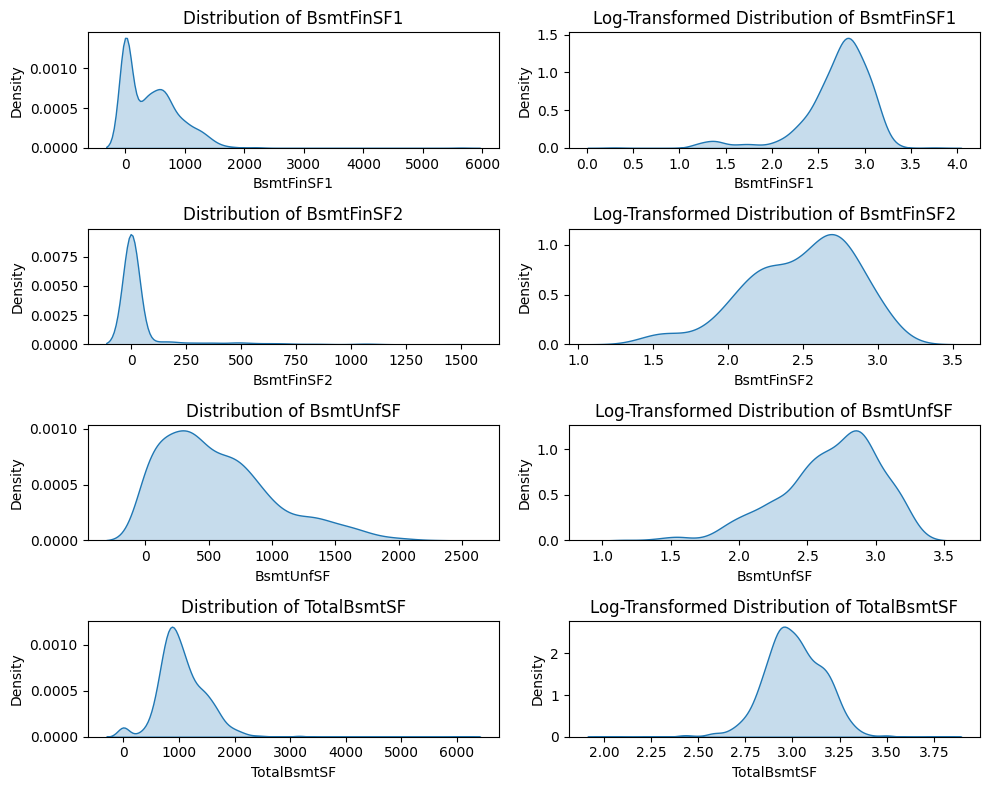

In [697]:
fig = plt.figure(figsize=(10,8))

counter = 0

for i in ['BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF']:
    # Original data plot
    sub = fig.add_subplot(4, 2, counter + 1)
    g = sns.kdeplot(x=i, data=house_cleaned, fill=True)
    plt.title(f'Distribution of {i}')
    plt.xticks()
    
    # Log-transformed data plot
    sub = fig.add_subplot(4, 2, counter + 2)
    log_col = np.log10(house_cleaned[i])  # Use np.log1p for log(1 + x)
    g = sns.kdeplot(x=log_col, fill=True)
    plt.title(f'Log-Transformed Distribution of {i}')
    plt.xticks()

    counter = counter + 2

plt.tight_layout()
plt.show()

In [698]:
fig = make_subplots(rows=2, cols=2, 
                    subplot_titles=(
                        'BsmtFinSF1 vs SalePrice',
                        'BsmtFinSF2 vs SalePrice',
                        'BsmtUnfSF vs SalePrice',
                        'TotalBsmtSF vs SalePrice'
                    ))

columns = [
    ("BsmtFinSF1", "SalePrice"),
    ("BsmtFinSF2", "SalePrice"),
    ("BsmtUnfSF", "SalePrice"),
    ("TotalBsmtSF", "SalePrice")
]

# Loop through each pair and create the scatter plot with a regression line
for i, (x_col, y_col) in enumerate(columns):
    scatter = px.scatter(x=house_cleaned[x_col], y=house_cleaned[y_col], trendline="ols", trendline_color_override="red").data
    fig.add_trace(scatter[0], row=i//2+1, col=i%2+1)  # Add scatter plot
    fig.add_trace(scatter[1], row=i//2+1, col=i%2+1)  # Add trendline

# Update layout for the figure
fig.update_layout(height=900, width=900, 
                  title_text="Scatter Plots of Basement Features vs SalePrice",
                  showlegend=False)

# Update individual subplot axes titles
for i, (x_col, y_col) in enumerate(columns):
    fig.update_xaxes(title_text=x_col, row=i//2+1, col=i%2+1)
    fig.update_yaxes(title_text=y_col, row=i//2+1, col=i%2+1)

# Show the plot
fig.show()

In [699]:
house_cleaned = house_cleaned.drop(columns=['BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF'])

### Columns:'1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea'

In [700]:
# Create subplots
fig = make_subplots(rows=3, cols=1, 
                    subplot_titles=(
                        '1stFlrSF vs SalePrice',
                        '2ndFlrSF vs SalePrice',
                        'GrLivArea vs SalePrice',
                    ))

# First scatter plot (LotFrontage vs LotArea)
scatter1 = px.scatter(x=house_cleaned["1stFlrSF"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline1 = px.scatter(x=house_cleaned["1stFlrSF"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter1, row=1, col=1)
fig.add_trace(trendline1, row=1, col=1)

# Second scatter plot (LotArea vs SalePrice)
scatter2 = px.scatter(x=house_cleaned["2ndFlrSF"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline2 = px.scatter(x=house_cleaned["2ndFlrSF"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter2, row=2, col=1)
fig.add_trace(trendline2, row=2, col=1)

# Third scatter plot (LotFrontage vs SalePrice)
scatter3 = px.scatter(y=house_cleaned["SalePrice"], 
                      x=house_cleaned["GrLivArea"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline3 = px.scatter(y=house_cleaned["SalePrice"], 
                        x=house_cleaned["GrLivArea"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter3, row=3, col=1)
fig.add_trace(trendline3, row=3, col=1)

# Update layout for the entire figure
fig.update_layout(height=900, 
                  width=1000, 
                  title_text="Combined Scatter Plots",
                  showlegend=False)

# Update individual subplot axes titles
fig.update_xaxes(title_text="1stFlrSF", row=1, col=1)
fig.update_yaxes(title_text="SalePrice", row=1, col=1)

fig.update_xaxes(title_text="2ndFlrSF", row=2, col=1)
fig.update_yaxes(title_text="SalePrice", row=2, col=1)

fig.update_xaxes(title_text="GrLivArea", row=3, col=1)
fig.update_yaxes(title_text="SalePrice", row=3, col=1)

fig.show()

In [701]:
house_cleaned = house_cleaned.drop(columns=["LowQualFinSF", "2ndFlrSF"])

### Columns: 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath'

In [702]:
house_cleaned['TotalBathrooms'] = (house_cleaned['FullBath'] + (0.5 * house_cleaned['HalfBath']))

In [703]:
house_cleaned[['TotalBathrooms', "SalePrice"]].corr()

,TotalBathrooms,SalePrice
TotalBathrooms,1.000000,0.597966
SalePrice,0.597966,1.000000


In [704]:
# Create a subplot with 3 rows and 1 column
fig = make_subplots(rows=3, cols=1, 
                    subplot_titles=(
                        'TotalBathrooms vs SalePrice',
                        'FullBath vs SalePrice',
                        'HalfBath vs SalePrice',
                    ))

# First box plot (TotalBathrooms vs SalePrice)
fig.add_trace(
    go.Box(x=house_cleaned['TotalBathrooms'].astype(str), 
           y=house_cleaned['SalePrice'], 
           boxpoints='all', 
           whiskerwidth=0.5,
           marker_color='orange',
           name='TotalBathrooms'),
    row=1, col=1
)

# Second box plot (FullBath vs SalePrice)
fig.add_trace(
    go.Box(x=house_cleaned['FullBath'].astype(str), 
           y=house_cleaned['SalePrice'], 
           boxpoints='all', 
           whiskerwidth=0.5,
           marker_color='green',
           name='FullBath'),
    row=2, col=1
)

# Third box plot (HalfBath vs SalePrice)
fig.add_trace(
    go.Box(x=house_cleaned['HalfBath'].astype(str), 
           y=house_cleaned['SalePrice'], 
           boxpoints='all', 
           whiskerwidth=0.5,
           marker_color='blue',
           name='HalfBath'),
    row=3, col=1
)

# Update layout for the entire figure
fig.update_layout(height=1200, 
                  width=1000, 
                  title_text="Combined Box Plots",
                  showlegend=False)

# Update individual subplot axes titles
fig.update_xaxes(title_text="TotalBathrooms", row=1, col=1)
fig.update_yaxes(title_text="SalePrice", row=1, col=1)

fig.update_xaxes(title_text="FullBath", row=2, col=1)
fig.update_yaxes(title_text="SalePrice", row=2, col=1)

fig.update_xaxes(title_text="HalfBath", row=3, col=1)
fig.update_yaxes(title_text="SalePrice", row=3, col=1)

fig.show()

In [705]:
house_cleaned["TotalBathrooms"].value_counts()

TotalBathrooms
1.0    469
2.0    433
2.5    334
1.5    180
3.0     20
3.5     18
0.5      3
0.0      3
Name: count, dtype: int64

In [706]:
house_cleaned = house_cleaned.drop(columns=["BsmtFullBath", "BsmtHalfBath", "FullBath","HalfBath"])

- Comments:
    - Combine HalfBath and FullBath together in TotalBath that has the same correltation of both
    - drop other two columns as they don't have too much correlation with the target

- Insights:
    - almost all houses have from 1 to 3 total bathrooms
    - houses with 2.5 bathrooms have range of 106k to 308 k
    - houses with 2 bathrooms have range of55k to 360k

### Columns: 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces'

In [707]:
house_cleaned["KitchenAbvGr"].value_counts()

KitchenAbvGr
1    1392
2      65
3       2
0       1
Name: count, dtype: int64

In [708]:
house_cleaned["BedroomAbvGr"].value_counts()

BedroomAbvGr
3    804
2    358
4    213
1     50
5     21
6      7
0      6
8      1
Name: count, dtype: int64

In [709]:
house_cleaned = house_cleaned.drop(columns=["BedroomAbvGr", "KitchenAbvGr"])

In [710]:
house_cleaned["Fireplaces"].value_counts()

Fireplaces
0    690
1    650
2    115
3      5
Name: count, dtype: int64

In [711]:
house_cleaned["TotRmsAbvGrd"].value_counts()

TotRmsAbvGrd
6     402
7     329
5     275
8     187
4      97
9      75
10     47
11     18
3      17
12     11
2       1
14      1
Name: count, dtype: int64

In [712]:
fig = make_subplots(rows=2, cols=1, subplot_titles=('Fireplaces vs SalePrice', 'TotRmsAbvGrd vs SalePrice'))

# Add the first violin plot for Fireplaces in the first subplot
fig.add_trace(
    go.Violin(x=house_cleaned['Fireplaces'].astype(str), 
              y=house_cleaned['SalePrice'], 
              box_visible=True, 
              points='all', 
              meanline_visible=True,
              line_color='blue',
              name='Fireplaces'),
    row=1, col=1
)

# Add the second violin plot for TotRmsAbvGrd in the second subplot
fig.add_trace(
    go.Violin(x=house_cleaned['TotRmsAbvGrd'].astype(str), 
              y=house_cleaned['SalePrice'], 
              box_visible=True, 
              points='all', 
              meanline_visible=True,
              line_color='orange',
              name='TotRmsAbvGrd'),
    row=2, col=1
)

# Update the layout for the figure
fig.update_layout(
    title_text='Violin Plots of SalePrice by Fireplaces and TotRmsAbvGrd',
    yaxis_title='SalePrice',
    showlegend=False,
    height=900, 
    width=1100, 
)

# Show the plot
fig.show()

- Insights:
    - houses with at most one fireplaces (0,1) have most sale prices
        - houses with no fire place ranges from 35k to 240k
        - houses with one fire place ranges from 60k to 395k
    - houses with 5 to 8 total rooms have most sale prices

### Columns: 'GarageCars', 'GarageArea'

In [713]:
house_cleaned["GarageArea"].value_counts()

GarageArea
0      81
440    49
576    47
240    38
484    34
       ..
320     1
594     1
831     1
878     1
192     1
Name: count, Length: 441, dtype: int64

In [714]:
house_cleaned["GarageCars"].value_counts()

GarageCars
2    824
1    369
3    181
0     81
4      5
Name: count, dtype: int64

In [715]:
# Create subplots
fig = make_subplots(rows=3, cols=1, 
                    subplot_titles=(
                        'GarageArea vs SalePrice',
                        'GarageCars vs SalePrice',
                        'GarageCars vs GarageArea'
                    ))

# First scatter plot (LotFrontage vs LotArea)
scatter1 = px.scatter(x=house_cleaned["GarageArea"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline1 = px.scatter(x=house_cleaned["GarageArea"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter1, row=1, col=1)
fig.add_trace(trendline1, row=1, col=1)

# Second scatter plot (LotArea vs SalePrice)
fig.add_trace(
    go.Violin(x=house_cleaned['GarageCars'].astype(str), 
              y=house_cleaned['SalePrice'], 
              box_visible=True, 
              points='all', 
              meanline_visible=True,
              line_color='blue',
              name='GarageCars'),
    row=2, col=1
)

# Third scatter plot (LotFrontage vs SalePrice)
fig.add_trace(
    go.Violin(x=house_cleaned['GarageCars'].astype(str), 
              y=house_cleaned['GarageArea'], 
              box_visible=True, 
              points='all', 
              meanline_visible=True,
              line_color='blue',
              name='GarageCars'),
    row=3, col=1
)

# Update layout for the entire figure
fig.update_layout(height=900, 
                  width=1000, 
                  title_text="Combined Scatter Plots",
                  showlegend=False)

# Update individual subplot axes titles
fig.update_xaxes(title_text="GarageArea", row=1, col=1)
fig.update_yaxes(title_text="SalePrice", row=1, col=1)

fig.update_xaxes(title_text="GarageCars", row=2, col=1)
fig.update_yaxes(title_text="SalePrice", row=2, col=1)

fig.update_xaxes(title_text="GarageCars", row=3, col=1)
fig.update_yaxes(title_text="GarageArea", row=3, col=1)

fig.show()

- Insights:
    - Most of the Garages have area between 200 to 900 SF with 1 to 3 cars inside
    - garages with 2 cars have range of 56k to 307k and area of 320 to 750 SF
    - garages with 3 cars have range of 81k to 500k and area of 594 to 1069 SF

### Columns: 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch'

In [716]:
# Initialize the new columns
house_cleaned['PorchType'] = ''
house_cleaned['PorchSF'] = 0

# Iterate over each row and combine the values
for index, row in house_cleaned.iterrows():
    porch_types = []
    porch_sf = 0
    
    if row['OpenPorchSF'] > 0:
        porch_types.append('OpenPorch')
        porch_sf += row['OpenPorchSF']
    
    if row['EnclosedPorch'] > 0:
        porch_types.append('EnclosedPorch')
        porch_sf += row['EnclosedPorch']
    
    if row['3SsnPorch'] > 0:
        porch_types.append('3SsnPorch')
        porch_sf += row['3SsnPorch']
    
    if row['ScreenPorch'] > 0:
        porch_types.append('ScreenPorch')
        porch_sf += row['ScreenPorch']
    
    house_cleaned.at[index, 'PorchType'] = ', '.join(porch_types)
    house_cleaned.at[index, 'PorchSF'] = porch_sf

house_cleaned["PorchType"] = house_cleaned["PorchType"].replace({'':"No Porch"})

house_cleaned[['PorchType', 'PorchSF']]

,PorchType,PorchSF
0,OpenPorch,61
1,No Porch,0
2,OpenPorch,42
3,"OpenPorch, EnclosedPorch",307
4,OpenPorch,84
...,...,...
1455,OpenPorch,40
1456,No Porch,0
1457,OpenPorch,60
1458,EnclosedPorch,112


In [717]:
px.histogram(house_cleaned["PorchType"], nbins=100)

In [718]:
house_cleaned[["PorchSF", "SalePrice"]].corr()

,PorchSF,SalePrice
PorchSF,1.000000,0.195739
SalePrice,0.195739,1.000000


In [719]:
porch = ['OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch']

for col in porch:
    print(f"{col}:{house_cleaned[col].value_counts()}")
    print("-" * 50)

OpenPorchSF:OpenPorchSF
0      656
36      29
48      22
20      21
40      19
      ... 
11       1
523      1
125      1
137      1
236      1
Name: count, Length: 202, dtype: int64
--------------------------------------------------
EnclosedPorch:EnclosedPorch
0      1252
112      15
96        6
192       5
144       5
       ... 
54        1
136       1
148       1
140       1
99        1
Name: count, Length: 120, dtype: int64
--------------------------------------------------
3SsnPorch:3SsnPorch
0      1436
168       3
144       2
180       2
216       2
290       1
153       1
96        1
23        1
162       1
182       1
196       1
320       1
245       1
238       1
508       1
140       1
130       1
407       1
304       1
Name: count, dtype: int64
--------------------------------------------------
ScreenPorch:ScreenPorch
0      1344
192       6
120       5
224       5
189       4
180       4
147       3
90        3
160       3
144       3
126       3
168       3
198       

- Insights:
    - most of the porch types are `OpenPorch` and their area isn't too much correlated with the target
    - drop all of them and keep only `OpenPorch` Column

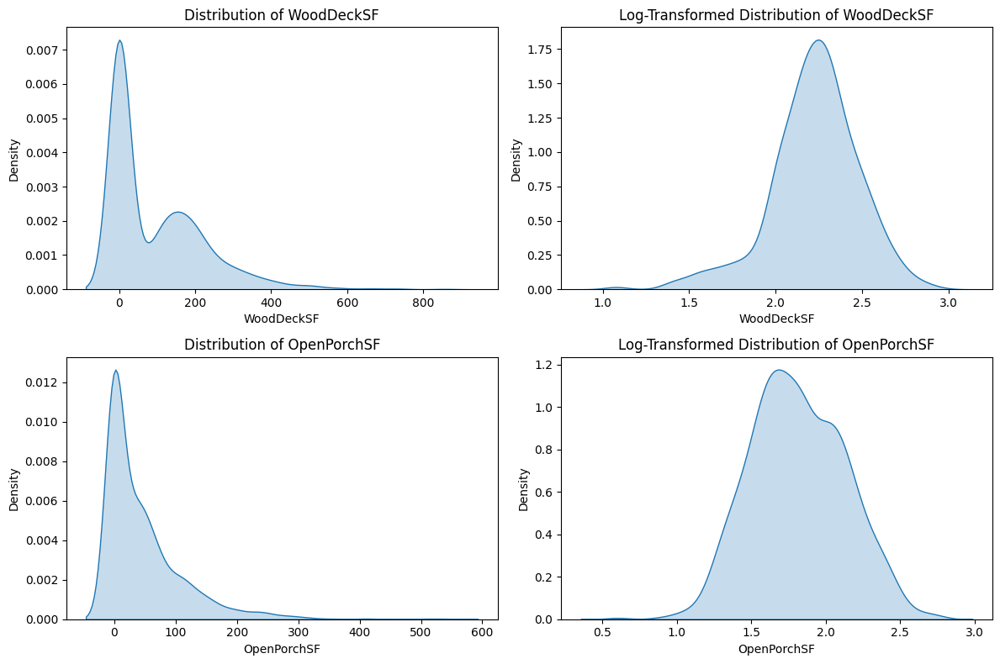

In [720]:
fig = plt.figure(figsize=(12,8))

counter = 0

for i in ["WoodDeckSF", "OpenPorchSF"]:
    # Original data plot
    sub = fig.add_subplot(2, 2, counter + 1)
    g = sns.kdeplot(x=i, data=house_cleaned, fill=True)
    plt.title(f'Distribution of {i}')
    plt.xticks()
    
    # Log-transformed data plot
    sub = fig.add_subplot(2, 2, counter + 2)
    log_col = np.log10(house_cleaned[i])  # Use np.log1p for log(1 + x)
    g = sns.kdeplot(x=log_col, fill=True)
    plt.title(f'Log-Transformed Distribution of {i}')
    plt.xticks()

    counter = counter + 2

plt.tight_layout()
plt.show()

In [721]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Create subplots
fig = make_subplots(rows=2, cols=1, 
                    subplot_titles=(
                        'WoodDeckSF vs SalePrice',
                        'OpenPorchSF vs SalePrice',
                    ))

# First scatter plot (LotFrontage vs LotArea)
scatter1 = px.scatter(x=house_cleaned["WoodDeckSF"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline1 = px.scatter(x=house_cleaned["WoodDeckSF"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter1, row=1, col=1)
fig.add_trace(trendline1, row=1, col=1)

# Second scatter plot (LotArea vs SalePrice)
scatter2 = px.scatter(y=house_cleaned["SalePrice"], 
                      x=house_cleaned["OpenPorchSF"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline2 = px.scatter(y=house_cleaned["SalePrice"], 
                        x=house_cleaned["OpenPorchSF"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter2, row=2, col=1)
fig.add_trace(trendline2, row=2, col=1)

# Update layout for the entire figure
fig.update_layout(height=900, 
                  width=1000, 
                  title_text="Combined Scatter Plots",
                  showlegend=False)

# Update individual subplot axes titles
fig.update_xaxes(title_text="WoodDeckSF", row=1, col=1)
fig.update_yaxes(title_text="SalePrice", row=1, col=1)

fig.update_xaxes(title_text="OpenPorchSF", row=2, col=1)
fig.update_yaxes(title_text="SalePrice", row=2, col=1)

fig.show()

In [722]:
house_cleaned = house_cleaned.drop(columns=["PorchSF","EnclosedPorch", "3SsnPorch","ScreenPorch", "PorchType"])

### Columns: 'PoolArea', 'MiscVal'

In [723]:
house_cleaned["PoolArea"].value_counts()

PoolArea
0      1453
512       1
648       1
576       1
555       1
480       1
519       1
738       1
Name: count, dtype: int64

In [724]:
house_cleaned["MiscVal"].value_counts()

MiscVal
0        1408
400        11
500         8
700         5
450         4
600         4
2000        4
1200        2
480         2
15500       1
800         1
350         1
3500        1
1300        1
54          1
620         1
560         1
1400        1
8300        1
1150        1
2500        1
Name: count, dtype: int64

In [725]:
fig = make_subplots(rows=2, cols=1, 
                    subplot_titles=(
                        'PoolArea vs SalePrice',
                        'MiscVal vs SalePrice',
                    ))

# First scatter plot (LotFrontage vs LotArea)
scatter1 = px.scatter(x=house_cleaned["PoolArea"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline1 = px.scatter(x=house_cleaned["PoolArea"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter1, row=1, col=1)
fig.add_trace(trendline1, row=1, col=1)

# Second scatter plot (LotArea vs SalePrice)
scatter2 = px.scatter(x=house_cleaned["MiscVal"], 
                      y=house_cleaned["SalePrice"], 
                      trendline='ols',
                      trendline_color_override="red").data[0]

trendline2 = px.scatter(x=house_cleaned["MiscVal"], 
                        y=house_cleaned["SalePrice"], 
                        trendline='ols',
                        trendline_color_override="red").data[1]

fig.add_trace(scatter2, row=2, col=1)
fig.add_trace(trendline2, row=2, col=1)

# Update layout for the entire figure
fig.update_layout(height=900, 
                  width=1000, 
                  title_text="Combined Scatter Plots",
                  showlegend=False)

# Update individual subplot axes titles
fig.update_xaxes(title_text="PoolArea", row=1, col=1)
fig.update_yaxes(title_text="SalePrice", row=1, col=1)

fig.update_xaxes(title_text="MiscVal", row=2, col=1)
fig.update_yaxes(title_text="SalePrice", row=2, col=1)

fig.show()

- Insights:
    - Nearly All of the houses has no pools nor miscellaneous feature like second garage, tennis court, shed or elevator
    - we can drop both of them as they have no correlation with SalePrice, our target column

In [726]:
house_cleaned = house_cleaned.drop(columns=['PoolArea', 'MiscVal'])

### Correlation Matrix

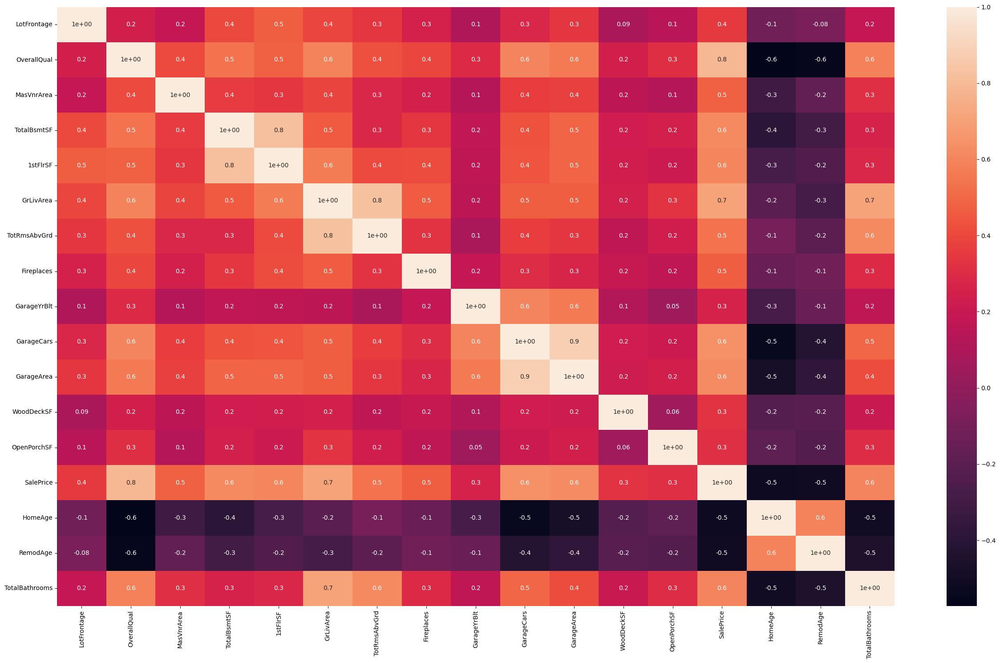

<Figure size 640x480 with 0 Axes>

In [727]:
plt.figure(figsize=(25,15))
sns.heatmap(house_cleaned.select_dtypes(exclude=["object", "category"]).corr(), annot=True, fmt="1.1")
plt.tight_layout()
plt.figure();

### Target Column: 'SalePrice'

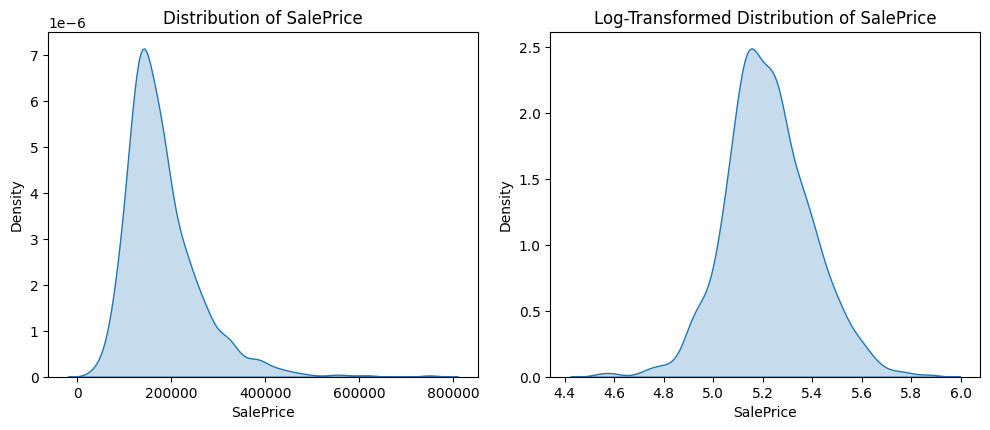

In [728]:
fig = plt.figure(figsize=(10,8))

counter = 0

for i in ["SalePrice"]:
    # Original data plot
    sub = fig.add_subplot(2, 2, counter + 1)
    g = sns.kdeplot(x=i, data=house_cleaned, fill=True)
    plt.title(f'Distribution of {i}')
    plt.xticks()
    
    # Log-transformed data plot
    sub = fig.add_subplot(2, 2, counter + 2)
    log_col = np.log10(house_cleaned[i])  # Use np.log1p for log(1 + x)
    g = sns.kdeplot(x=log_col, fill=True)
    plt.title(f'Log-Transformed Distribution of {i}')
    plt.xticks()

    counter = counter + 2

plt.tight_layout()
plt.show()

In [729]:
house_cleaned["SalePrice_log"] = np.log10(house_cleaned["SalePrice"])

<Figure size 640x480 with 0 Axes>

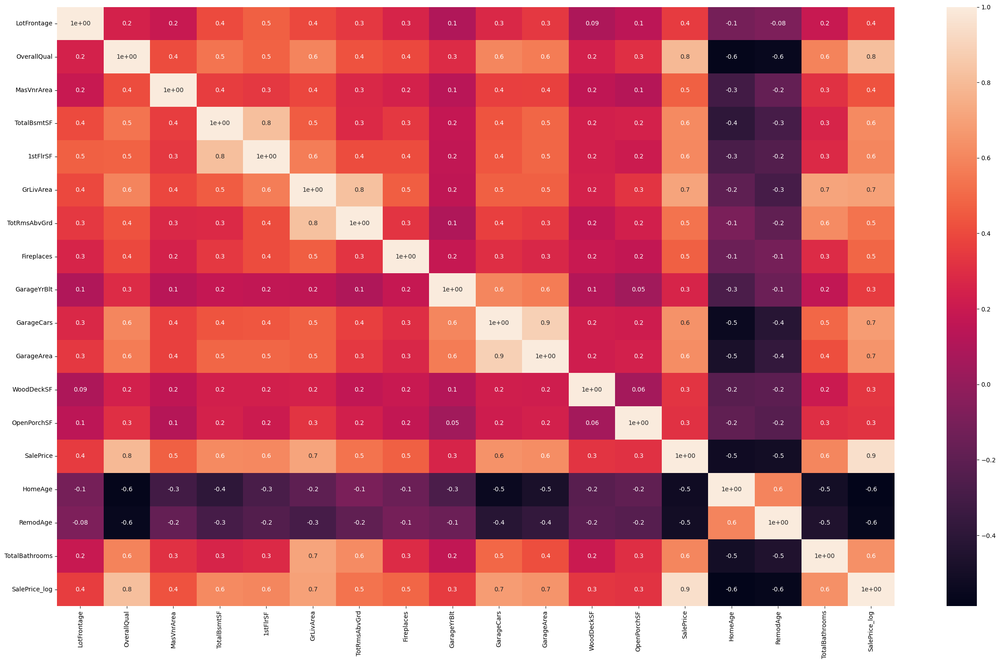

<Figure size 640x480 with 0 Axes>

In [730]:
plt.figure(figsize=(25,15))
sns.heatmap(house_cleaned.select_dtypes(exclude=["object","category"]).corr(), annot=True, fmt="1.1")
plt.tight_layout()
plt.figure()

## Categorical Columns

### Cat Missing Values

In [731]:
cat_cols.isna().sum()

MSZoning         0
Street           0
Alley            0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinType2     0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
KitchenQual      0
Functional       0
FireplaceQu      0
GarageType       0
GarageFinish     0
GarageQual       0
GarageCond       0
PavedDrive       0
PoolQC           0
Fence            0
MiscFeature      0
SaleType         0
SaleCondition    0
dtype: int64

### Columns: 'MSZoning', 'Street', 'Alley'

In [732]:
house_cleaned["Street"].value_counts()

Street
Pave    1454
Grvl       6
Name: count, dtype: int64

In [733]:
house_cleaned["Alley"].value_counts()/1460

Alley
No      0.937671
Grvl    0.034247
Pave    0.028082
Name: count, dtype: float64

- Comments:
    - Almost all of the houses has paved street and with no alley access to them
    - These two features won't affect the sale price

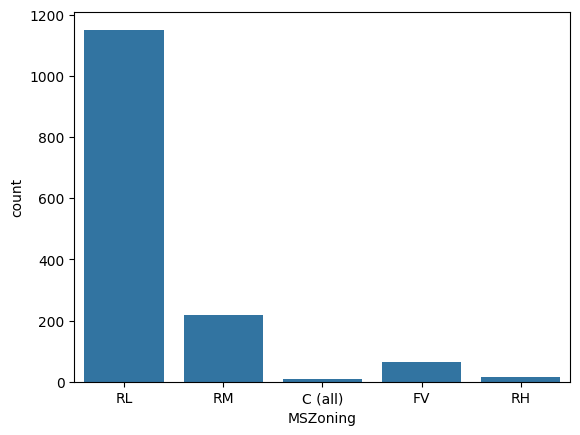

In [734]:
sns.countplot(x=house_cleaned["MSZoning"])
plt.show();

- Insights:
    - Most of the houses are in residentials with low and medium density

In [735]:
# Group by MSZoning and calculate the mean SalePrice
mszoning_sales = house.groupby('MSZoning')['SalePrice'].mean().reset_index()

fig = px.bar(x=mszoning_sales['MSZoning'], y=mszoning_sales['SalePrice'], text_auto=True)

fig.update_layout(height = 500, width=1000,
    title_text='MSZoning vs. SalePrice',
    xaxis_labelalias={'A'	:'Agriculture',
       'C'	:'Commercial',
       'FV'	:'Floating Village Residential',
       'I'	:'Industrial',
       'RH'	:'Residential High Density',
       'RL'	:'Residential Low Density',
       'RP'	:'Residential Low Density Park', 
       'RM'	:'Residential Medium Density'},
    xaxis_title='MSZoning',
    yaxis_title='Average SalePrice',)

fig.show()

- Insights:
  - houses in the Floating village residential that surrounded with water are the most with avg sales of 214k
  - second is resdintial with low desnsity with 191k

### Columns: 'LotShape' , 'LotConfig', 'LandContour', LandSlope'

In [736]:
house_cleaned["LotShape"].value_counts()

LotShape
Reg    925
IR1    484
IR2     41
IR3     10
Name: count, dtype: int64

In [737]:
house_cleaned["LotConfig"].value_counts()

LotConfig
Inside     1052
Corner      263
CulDSac      94
FR2          47
FR3           4
Name: count, dtype: int64

In [738]:
house_cleaned["LandContour"].value_counts()

LandContour
Lvl    1311
Bnk      63
HLS      50
Low      36
Name: count, dtype: int64

In [739]:
house_cleaned["LandSlope"].value_counts()

LandSlope
Gtl    1382
Mod      65
Sev      13
Name: count, dtype: int64

In [740]:
lotshape_labels = ['Regular','Slightly irregular','Moderately Irregular','Irregular']
lotshape_values = house_cleaned["LotShape"].value_counts()

# Create a pie chart
fig = px.pie(
    names=lotshape_labels,  # Labels of the pie chart
    values=lotshape_values, # Values corresponding to each label
    title="Distribution of LotShape",
    color_discrete_sequence=px.colors.sequential.Blues_r)

fig.update_layout(height=400, width=600)
# Show the pie chart
fig.show()

In [741]:
# Group by LotShape and calculate the mean SalePrice
shape_sales = house.groupby('LotShape')['SalePrice'].mean().reset_index()

# Group by LotConfig and calculate the mean SalePrice
config_sales = house.groupby('LotConfig')['SalePrice'].mean().reset_index()

# Group by LandContour and calculate the mean SalePrice
contour_sales = house.groupby('LandContour')['SalePrice'].mean().reset_index()

# Group by LandSlope and calculate the mean SalePrice
slope_sales = house.groupby('LandSlope')['SalePrice'].mean().reset_index()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=2, cols=2, subplot_titles=('LotShape vs. SalePrice', 'LotConfig vs. SalePrice','LandContour vs. SalePrice', 'LandSlope vs. SalePrice'))

# Add bar plot for LotShape vs. SalePrice
fig.add_trace(
    go.Bar(x=shape_sales['LotShape'], y=shape_sales['SalePrice'],texttemplate='%{y}', marker_color='darkorange', name='LotShape'),
    row=1, col=1
)

# Add bar plot for LotConfig vs. SalePrice
fig.add_trace(
    go.Bar(x=config_sales['LotConfig'], y=config_sales['SalePrice'],texttemplate='%{y}', marker_color='darkgreen', name='LotConfig'),
    row=1, col=2
)

# Add bar plot for LandContour vs. SalePrice
fig.add_trace(
    go.Bar(x=contour_sales['LandContour'], y=contour_sales['SalePrice'],texttemplate='%{y}', marker_color='darkblue', name='LandContour'),
    row=2, col=1
)

# Add bar plot for LandSlope vs. SalePrice
fig.add_trace(
    go.Bar(x=slope_sales['LandSlope'], y=slope_sales['SalePrice'],texttemplate='%{y}', marker_color='darkred', name='LandSlope'),
    row=2, col=2
)

# Update layout for the entire figure
fig.update_layout(height = 800, width=1100,
    title_text='LotShape, LotConfig, LandContour and LandSlope vs. SalePrice',
    yaxis_title='Average SalePrice',
    xaxis_labelalias={'Reg':	'Regular',	
       'IR1'	:'Slightly Irregular',
       'IR2'	:'Moderately Irregular',
       'IR3'	:'Irregular'},
    yaxis2_title='Average SalePrice',
    xaxis2_labelalias={'Inside':	'Inside',
       'Corner':	'Corner',
       'CulDSac':	'Cul-de-sac',
       'FR2':	'Frontage on 2 sides',
       'FR3':	'Frontage on 3 sides'},
    xaxis3_labelalias={'Lvl':	'Near Flat/Level',	
       'Bnk'	:'Banked',
       'HLS'	:'Hillside',
       'Low'	:'Depression'},
    yaxis3_title='Average SalePrice',
    yaxis4_title='Average SalePrice',
    xaxis4_labelalias = {'Gtl':	'Gentle',
       'Mod':	'Moderate',	
       'Sev':	'Severe'},
    xaxis=dict(tickangle=-45),
    xaxis2=dict(tickangle=-45)
)

# Show the figure
fig.show()

- Insights:
    - most of the houses are with LotConfig of inside so they are the most common and less expensive with 176k
    - houses with regular LotShape are the most common ones and less expensive

### Columns: 'Utilities', 'Neighbourhood', 'Condition1', 'Condition2'

In [742]:
house_cleaned["Utilities"].value_counts()

Utilities
AllPub    1459
NoSeWa       1
Name: count, dtype: int64

In [743]:
house_cleaned["Condition1"].value_counts()

Condition1
Norm      1260
Feedr       81
Artery      48
RRAn        26
PosN        19
RRAe        11
PosA         8
RRNn         5
RRNe         2
Name: count, dtype: int64

In [744]:
house_cleaned["Condition2"].value_counts()

Condition2
Norm      1445
Feedr        6
Artery       2
RRNn         2
PosN         2
PosA         1
RRAn         1
RRAe         1
Name: count, dtype: int64

- Insights:
    - most of the houses are normal in the second condition with no additional features
    - all of the houses have all the All public Utilities (E,G,W,& S)
- These two feature won't affect SalePrice

In [745]:
# Group by MSZoning and calculate the mean SalePrice
neigh_sales = house.groupby('Neighborhood')['SalePrice'].mean().reset_index()

fig = px.bar(x=neigh_sales['Neighborhood'], y=neigh_sales['SalePrice'], text_auto=True)

fig.update_layout(height = 600, width=1100,
    title_text='Neighborhood vs. SalePrice',
    xaxis_labelalias={'Blmngtn'	:'Bloomington Heights',
       'Blueste':	'Bluestem',
       'BrDale'	:'Briardale',
       'BrkSide':	'Brookside',
       'ClearCr':	'Clear Creek',
       'CollgCr':	'College Creek',
       'Crawfor':	'Crawford',
       'Edwards':	'Edwards',
       'Gilbert':	'Gilbert',
       'IDOTRR'	:'Iowa DOT and Rail Road',
       'MeadowV':	'Meadow Village',
       'Mitchel':	'Mitchell',
       'Names'	:'North Ames',
       'NoRidge':	'Northridge',
       'NPkVill':	'Northpark Villa',
       'NridgHt':	'Northridge Heights',
       'NWAmes'	:'Northwest Ames',
       'OldTown':	'Old Town',
       'SWISU'	:'South & West of Iowa State University',
       'Sawyer'	:'Sawyer',
       'SawyerW':	'Sawyer West',
       'Somerst':	'Somerset',
       'StoneBr':	'Stone Brook',
       'Timber':	'Timberland',
       'Veenker':	'Veenker'},
    xaxis_title='Neighborhood',
    yaxis_title='Average SalePrice',)

fig.show()

- Insights:
    - houses in the Northridge Location are with most sale prices of 335.3k
    - then, houses in  Northridge Heights with 316.3k
    - third, houses in Strone Brook with 310.5k

### Columns: 'BldgeType', 'HouseStyle', 'Foundation'

In [746]:
house_cleaned["BldgType"].value_counts()

BldgType
1Fam      1220
TwnhsE     114
Duplex      52
Twnhs       43
2fmCon      31
Name: count, dtype: int64

In [747]:
house_cleaned["HouseStyle"].value_counts()

HouseStyle
1Story    726
2Story    445
1.5Fin    154
SLvl       65
SFoyer     37
1.5Unf     14
2.5Unf     11
2.5Fin      8
Name: count, dtype: int64

In [748]:
house_cleaned["Foundation"].value_counts()

Foundation
PConc     647
CBlock    634
BrkTil    146
Slab       24
Stone       6
Wood        3
Name: count, dtype: int64

In [749]:
# Group by BldgType and calculate the mean SalePrice
build_sales = house.groupby('BldgType')['SalePrice'].mean().reset_index()

# Create a mapping dictionary for BldgType
bldgtype_mapping = {
    '1Fam': 'Single-family Detached',
    '2fmCon': 'Two-family Conversion',
    'Duplex': 'Duplex',
    'TwnhsE': 'Townhouse End Unit',
    'Twnhs': 'Townhouse Inside Unit'
}

# Apply the mapping to the BldgType column
build_sales['BldgType'] = build_sales['BldgType'].map(bldgtype_mapping)

# Group by HouseStyle and calculate the mean SalePrice
house_sales = house.groupby('HouseStyle')['SalePrice'].mean().reset_index()

housestyle_mapping = {
       '1Story':	'1 Story',
       '1.5Fin':	'1.5 Story: 2nd level finished',
       '1.5Unf':	'1.5 Story: 2nd level unfinished',
       '2Story':	'2 Story',
       '2.5Fin':	'2.5 Story: 2nd level finished',
       '2.5Unf':	'2.5 Story: 2nd level unfinished',
       'SFoyer':	'Split Foyer',
       'SLvl':	'Split Level'
}

house_sales['HouseStyle'] = house_sales['HouseStyle'].map(housestyle_mapping)

# Group by Foundation and calculate the mean SalePrice
found_sales = house.groupby('Foundation')['SalePrice'].mean().reset_index()

found_mapping={
       'BrkTil'	:'Brick & Tile',
       'CBlock':	'Cinder Block',
       'PConc':	'Poured Contrete',	
       'Slab':	'Slab',
       'Stone':	'Stone',
       'Wood':	'Wood'
}


found_sales['Foundation'] = found_sales['Foundation'].map(found_mapping)

# Create subplots: 3 rows, 2 columns
fig = make_subplots(
    rows=3, cols=2, 
    subplot_titles=(
        'BldgType vs. SalePrice', 'BldgType Distribution',
        'HouseStyle vs. SalePrice', 'HouseStyle Distribution',
        'Foundation vs. SalePrice', 'Foundation Distribution'
    ),
    specs=[[{"type": "bar"}, {"type": "pie"}],
           [{"type": "bar"}, {"type": "pie"}],
           [{"type": "bar"}, {"type": "pie"}]]
)

# Add bar plot for BldgType vs. SalePrice
fig.add_trace(
    go.Bar(x=build_sales['BldgType'], y=build_sales['SalePrice'], texttemplate='%{y}', name='BldgType', marker_color='lightgreen'),
    row=1, col=1
)

# Add pie chart for BldgType distribution
fig.add_trace(
    go.Pie(labels=build_sales['BldgType'], values=build_sales['SalePrice'], name='BldgType Distribution', marker=dict(colors=px.colors.sequential.Greens)),
    row=1, col=2
)

# Add bar plot for HouseStyle vs. SalePrice
fig.add_trace(
    go.Bar(x=house_sales['HouseStyle'], y=house_sales['SalePrice'], texttemplate='%{y}', name='HouseStyle', marker_color='lightblue'),
    row=2, col=1
)

# Add pie chart for HouseStyle distribution
fig.add_trace(
    go.Pie(labels=house_sales['HouseStyle'], values=house_sales['SalePrice'], name='HouseStyle Distribution', marker=dict(colors=px.colors.sequential.Blues)),
    row=2, col=2
)

# Add bar plot for Foundation vs. SalePrice
fig.add_trace(
    go.Bar(x=found_sales['Foundation'], y=found_sales['SalePrice'], texttemplate='%{y}', name='Foundation', marker_color='mintcream'),
    row=3, col=1
)

# Add pie chart for Foundation distribution
fig.add_trace(
    go.Pie(labels=found_sales['Foundation'], values=found_sales['SalePrice'], name='Foundation Distribution', marker=dict(colors=px.colors.sequential.Mint)),
    row=3, col=2
)

# Update layout for the entire figure
fig.update_layout(
    height=1500, width=1200,
    title_text='Comparison of Building Type, HouseStyle, and Foundation vs. SalePrice with Distribution',
    showlegend=False
)

# Update axes for bar plots
fig.update_xaxes(title_text='BldgType', row=1, col=1, tickangle=-45)
fig.update_xaxes(title_text='HouseStyle', row=2, col=1, tickangle=-45)
fig.update_xaxes(title_text='Foundation', row=3, col=1, tickangle=-45)

fig.update_yaxes(title_text='Average SalePrice', row=1, col=1)
fig.update_yaxes(title_text='Average SalePrice', row=2, col=1)
fig.update_yaxes(title_text='Average SalePrice', row=3, col=1)

# Show the figure
fig.show()

- Insights:
    - houses with poured concrete in its foundation is the most common and most in sale prices with 225k as it provides more stability and be more solid
    - houses with more stories finished is with most sale prices as they have more space to live and they are the most common
        - most sale price houses are 2.5 Story with 2nd level finished with 220k
        - second is the 2 story houses with 210k
    - houses with Single-Family detached are the most common for families and with the most sale prices of 186k
    - second is the townhouse end unit with 181k as they provide some privacy with its one shared wall with neighboured unit

### Columns: 'RoofStyle', 'RoofMatl`

In [750]:
house_cleaned["RoofStyle"].value_counts()

RoofStyle
Gable      1141
Hip         286
Flat         13
Gambrel      11
Mansard       7
Shed          2
Name: count, dtype: int64

In [751]:
house_cleaned["RoofMatl"].value_counts()

RoofMatl
CompShg    1434
Tar&Grv      11
WdShngl       6
WdShake       5
Metal         1
Membran       1
Roll          1
ClyTile       1
Name: count, dtype: int64

- Insights:
    - nearly all of the houses have the same roof material of Standard (Composite) Shingle so it won't affect Sale Price

In [752]:
# Group by RoofStyle and calculate the mean SalePrice
mszoning_sales = house.groupby('RoofStyle')['SalePrice'].mean().reset_index()

fig = px.bar(x=mszoning_sales['RoofStyle'], y=mszoning_sales['SalePrice'], text_auto=True)

fig.update_layout(height = 500, width=1000,
    title_text='RoofStyle vs. SalePrice',
    xaxis_title='RoofStyle',
    yaxis_title='Average SalePrice',)

fig.show()

- Insights:
    - most common roof styles are Gable used more in viilages with less sale prices of 149k
    - then roof styles of Hip as they more solid and stable with sale prices of 219k
    - third common one is Flat as they are modern and simple with sale prices of 195k

### Columns: 'Exterior1st', 'Exterior2nd', 'ExterQual', 'ExterCond', 'MasVnrType'

In [753]:
house_cleaned["Exterior1st"].value_counts()

Exterior1st
VinylSd    515
HdBoard    222
MetalSd    220
Wd Sdng    206
Plywood    108
CemntBd     61
BrkFace     50
WdShing     26
Stucco      25
AsbShng     20
BrkComm      2
Stone        2
AsphShn      1
ImStucc      1
CBlock       1
Name: count, dtype: int64

In [754]:
house_cleaned["Exterior2nd"].value_counts()

Exterior2nd
VinylSd    504
MetalSd    214
HdBoard    207
Wd Sdng    197
Plywood    142
CmentBd     60
Wd Shng     38
Stucco      26
BrkFace     25
AsbShng     20
ImStucc     10
Brk Cmn      7
Stone        5
AsphShn      3
Other        1
CBlock       1
Name: count, dtype: int64

In [755]:
house_cleaned["ExterQual"].value_counts()

ExterQual
TA    906
Gd    488
Ex     52
Fa     14
Name: count, dtype: int64

In [756]:
house_cleaned["ExterCond"].value_counts()

ExterCond
TA    1282
Gd     146
Fa      28
Ex       3
Po       1
Name: count, dtype: int64

In [757]:
house_cleaned["MasVnrType"].value_counts()

MasVnrType
No         872
BrkFace    445
Stone      128
BrkCmn      15
Name: count, dtype: int64

In [758]:
# Group by Exterior1st and calculate the mean SalePrice
ext1_sales = house.groupby('Exterior1st')['SalePrice'].mean().reset_index()

# Group by Exterior2nd and calculate the mean SalePrice
ext2_sales = house.groupby('Exterior2nd')['SalePrice'].mean().reset_index()

# Group by ExterQual and calculate the mean SalePrice
extqual_sales = house.groupby('ExterQual')['SalePrice'].mean().reset_index()

# Group by ExterCond and calculate the mean SalePrice
extcond_sales = house.groupby('ExterCond')['SalePrice'].mean().reset_index()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=2, cols=2, subplot_titles=('Exterior1st vs. SalePrice', 'Exterior2nd vs. SalePrice','ExterQual vs. SalePrice', 'ExterCond vs. SalePrice'))

# Add bar plot for Exterior1st vs. SalePrice
fig.add_trace(
    go.Bar(x=ext1_sales['Exterior1st'], y=ext1_sales['SalePrice'],texttemplate='%{y}', marker_color='darkorange', name='Exterior1st'),
    row=1, col=1
)

# Add bar plot for Exterior2nd vs. SalePrice
fig.add_trace(
    go.Bar(x=ext2_sales['Exterior2nd'], y=ext2_sales['SalePrice'],texttemplate='%{y}', marker_color='darkgreen', name='Exterior2nd'),
    row=1, col=2
)

# Add bar plot for ExterQual vs. SalePrice
fig.add_trace(
    go.Bar(x=extqual_sales['ExterQual'], y=extqual_sales['SalePrice'],texttemplate='%{y}', marker_color='darkblue', name='ExterQual'),
    row=2, col=1
)

# Add bar plot for ExterCond vs. SalePrice
fig.add_trace(
    go.Bar(x=extcond_sales['ExterCond'], y=extcond_sales['SalePrice'],texttemplate='%{y}', marker_color='darkred', name='ExterCond'),
    row=2, col=2
)

# Update layout for the entire figure
fig.update_layout(height = 800, width=1100,
    title_text='Exterior1st, Exterior1st, ExterQual and ExterCond vs. SalePrice',
    yaxis_title='Average SalePrice',
    yaxis2_title='Average SalePrice',
    xaxis3_labelalias={'Ex':	'Excellent',	
       'Gd'	:'Good',
       'TA'	:'Average',
       'Fa'	:'Fair',
        'Po':'Poor'},
    yaxis3_title='Average SalePrice',
    yaxis4_title='Average SalePrice',
    xaxis4_labelalias = {'Ex':	'Excellent',	
       'Gd'	:'Good',
       'TA'	:'Average',
       'Fa'	:'Fair',
        'Po':'Poor'},
    xaxis=dict(tickangle=-45),
    xaxis2=dict(tickangle=-45)
)

# Show the figure
fig.show()

- Insights:
    - most of the houses have exterior quality and condition of Average
    - as the quality and condition of the exterior increases, the avg sale prices increase

In [759]:
# Group by MasVnrType and calculate the mean SalePrice
masvnr_sales = house_cleaned.groupby('MasVnrType')['SalePrice'].mean().reset_index()

fig = px.bar(x=masvnr_sales['MasVnrType'], y=masvnr_sales['SalePrice'], text_auto=True)

fig.update_layout(height = 500, width=1000,
    xaxis_labelalias={'BrkCmn':	'Brick Common',
       'BrkFace':	'Brick Face',
       'CBlock'	:'Cinder Block',
       'No'	:'No',
       'Stone'	:'Stone'
    },
    title_text='Masonry veneer type vs. SalePrice',
    xaxis_title='Masonry veneer type',
    yaxis_title='Average SalePrice',)

fig.show()

- Insights:
    - most houses has no masonry veneer with it.
    - most common type is brick face woth 205k for average sale prices

### Columns: 'BsmtQual', 'BsmtCond', BsmtExposure', 'BsmtFinType1', 'BsmtFinType2'

In [760]:
house_cleaned["BsmtFinType1"].value_counts()

BsmtFinType1
Unf           430
GLQ           418
ALQ           220
BLQ           148
Rec           133
LwQ            74
No Basment     37
Name: count, dtype: int64

In [761]:
house_cleaned["BsmtFinType2"].value_counts()

BsmtFinType2
Unf           1256
Rec             54
LwQ             46
No Basment      38
BLQ             33
ALQ             19
GLQ             14
Name: count, dtype: int64

In [762]:
house_cleaned["BsmtExposure"].value_counts()

BsmtExposure
No            953
Av            221
Gd            134
Mn            114
No Basment     38
Name: count, dtype: int64

In [763]:
# Group by BsmtQual and calculate the mean SalePrice
bsmtqual_sales = house.groupby('BsmtQual')['SalePrice'].mean().reset_index()

# Group by BsmtCond and calculate the mean SalePrice
bsmtcond_sales = house.groupby('BsmtCond')['SalePrice'].mean().reset_index()

# Group by BsmtExposure and calculate the mean SalePrice
bsmtexp_sales = house.groupby('BsmtExposure')['SalePrice'].mean().reset_index()

# Group by BsmtFinType1 and calculate the mean SalePrice
bsmt1_sales = house_cleaned.groupby('BsmtFinType1')['SalePrice'].mean().reset_index()

# Group by BsmtFinType2 and calculate the mean SalePrice
bsmt2_sales = house.groupby('BsmtFinType2')['SalePrice'].mean().reset_index()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=3, cols=2, subplot_titles=('BsmtQual vs. SalePrice', 'BsmtCond vs. SalePrice','BsmtExposure vs. SalePrice', 'BsmtFinType1 vs. SalePrice', 'BsmtFinType2 vs. SalePrice'))

# Add bar plot for BsmtQual vs. SalePrice
fig.add_trace(
    go.Bar(x=bsmtqual_sales['BsmtQual'], y=bsmtqual_sales['SalePrice'],texttemplate='%{y}', marker_color='darkorange', name='BsmtQual'),
    row=1, col=1
)

# Add bar plot for BsmtCond vs. SalePrice
fig.add_trace(
    go.Bar(x=bsmtcond_sales['BsmtCond'], y=bsmtcond_sales['SalePrice'],texttemplate='%{y}', marker_color='darkgreen', name='BsmtCond'),
    row=1, col=2
)

# Add bar plot for BsmtExposure vs. SalePrice
fig.add_trace(
    go.Bar(x=bsmtexp_sales['BsmtExposure'], y=bsmtexp_sales['SalePrice'],texttemplate='%{y}', marker_color='darkblue', name='BsmtExposure'),
    row=2, col=1
)

# Add bar plot for BsmtFinType1 vs. SalePrice
fig.add_trace(
    go.Bar(x=bsmt1_sales['BsmtFinType1'], y=bsmt1_sales['SalePrice'],texttemplate='%{y}', marker_color='darkred', name='BsmtFinType1'),
    row=2, col=2
)

# Add bar plot for BsmtFinType2 vs. SalePrice
fig.add_trace(
    go.Bar(x=bsmt2_sales['BsmtFinType2'], y=bsmt2_sales['SalePrice'],texttemplate='%{y}', marker_color='darkorchid', name='BsmtFinType2'),
    row=3, col=1
)


# Update layout for the entire figure
fig.update_layout(height = 1000, width=1100,
    title_text='BsmtQual, BsmtCond, BsmtExposure, BsmtFinType1 and BsmtFinType2 vs. SalePrice',
    yaxis_title='Average SalePrice',
    yaxis2_title='Average SalePrice',
    xaxis_labelalias={'Ex':	'Excellent',	
       'Gd'	:'Good',
       'TA'	:'Average',
       'Fa'	:'Fair',
        'Po':'Poor'},
    yaxis3_title='Average SalePrice',
    xaxis3_labelalias = {'Gd'	:'Good',
       'Av'	:'Average',
       'Mn'	:'Minimum',
        'No':'No'},
    yaxis4_title='Average SalePrice',
    yaxis5_title='Average SalePrice',
    xaxis2_labelalias = {'Ex':	'Excellent',	
       'Gd'	:'Good',
       'TA'	:'Average',
       'Fa'	:'Fair',
        'Po':'Poor'},
    xaxis=dict(tickangle=-45),
    xaxis2=dict(tickangle=-45)
)

# Show the figure
fig.show()

- Insights:
    - as basement quality and condition increases, the avg sale prices increases
    - the more the exposure of the basment to walkout or garden walls, the more avg sale prices

### Columns: 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Finctional', 'FirePlacesQu'

In [764]:
house_cleaned["Electrical"].value_counts()

Electrical
SBrkr    1335
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: count, dtype: int64

In [765]:
house_cleaned["Heating"].value_counts()

Heating
GasA     1428
GasW       18
Grav        7
Wall        4
OthW        2
Floor       1
Name: count, dtype: int64

In [766]:
house_cleaned["HeatingQC"].value_counts()

HeatingQC
Ex    741
TA    428
Gd    241
Fa     49
Po      1
Name: count, dtype: int64

In [767]:
house_cleaned["CentralAir"].value_counts()

CentralAir
Y    1365
N      95
Name: count, dtype: int64

- Comments:
    - nealry all of the houses has central air conditioner, same heating type and same electrical system so they won't affect sale prices

In [768]:
labels = ["Excellent", "Good", "Average", "Fair"]
values = house_cleaned["KitchenQual"].value_counts()

# Create a pie chart
fig = px.pie(
    names=labels,  # Labels of the pie chart
    values=values, # Values corresponding to each label
    title="Distribution of Kitchen Quality",
    color_discrete_sequence=px.colors.sequential.Blues_r)

fig.update_layout(height=400, width=600)
# Show the pie chart
fig.show()

In [769]:
# Group by MSZoning and calculate the mean SalePrice
kitchen_sales = house.groupby('KitchenQual')['SalePrice'].mean().reset_index()

# Group by GarageType and calculate the mean SalePrice
func_sales = house.groupby('Functional')['SalePrice'].mean().reset_index()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=('Kitchen Quality vs. SalePrice', 'Home functionality vs. SalePrice'))

# Add bar plot for MSZoning vs. SalePrice
fig.add_trace(
    go.Bar(x=kitchen_sales['KitchenQual'], y=kitchen_sales['SalePrice'],texttemplate='%{y}', marker_color='wheat', name='Kitchen Quality'),
    row=1, col=1
)

# Add bar plot for GarageType vs. SalePrice
fig.add_trace(
    go.Bar(x=func_sales['Functional'], y=func_sales['SalePrice'],texttemplate='%{y}', marker_color='lightblue', name='Home functionality'),
    row=1, col=2
)

# Update layout for the entire figure
fig.update_layout(height = 600, width=1100,
    xaxis_labelalias = {"Ex":"Excellent", "Gd":"Good", "TA":"Average","Fa":"Fair"},
    xaxis2_labelalias = {'Typ':'Typical Functionality',
       'Min1':	'Minor Deductions 1',
       'Min2'	:'Minor Deductions 2',
       'Mod'	:'Moderate Deductions',
       'Maj1':	'Major Deductions 1',
       'Maj2'	:'Major Deductions 2',
       'Sev'	:'Severely Damaged',
       'Sal'	:'Salvage only'},
    title_text='Kitchen Quality and Home functionality vs. SalePrice',
    xaxis_title='Kitchen Quality',
    yaxis_title='Average SalePrice',
    xaxis2_title='Home functionality',
    yaxis2_title='Average SalePrice',
    xaxis=dict(tickangle=-45),
    xaxis2=dict(tickangle=-45)
)

# Show the figure
fig.show()

- Insights:
    - As Kitchen Quality Increase, the average sale price of the house increase
    - Kitchens with Excellent quality are more expensive of 1.5 than kitchens with good guality
    - As the damage of the house increases (low functionality),  the avg sale price of the house decreases

- Insights:
    - As Kitchen Quality Increase, the average sale price of the house increase
    - Kitchens with Excellent quality are more expensive of 1.5 than kitchens with good guality
    - As the damage of the house increases (low functionality),  the avg sale price of the house decreases

In [770]:
house_cleaned["FireplaceQu"].value_counts()

FireplaceQu
No    690
Gd    380
TA    313
Fa     33
Ex     24
Po     20
Name: count, dtype: int64

In [771]:
# Group by FireplaceQu and calculate the mean SalePrice
firequal_sales = house_cleaned.groupby('FireplaceQu')['SalePrice'].mean().reset_index()

# Group by HeatingQC and calculate the mean SalePrice
func_sales = house.groupby('HeatingQC')['SalePrice'].mean().reset_index()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=('FireplaceQu vs. SalePrice', 'Home HeatingQC vs. SalePrice'))

# Add bar plot for FireplaceQu vs. SalePrice
fig.add_trace(
    go.Bar(x=firequal_sales['FireplaceQu'], y=firequal_sales['SalePrice'],texttemplate='%{y}', marker_color='lightblue',
    name='FireplaceQu'),
    row=1, col=1
)

# Add bar plot for HeatingQC vs. SalePrice
fig.add_trace(
    go.Bar(x=func_sales['HeatingQC'], y=func_sales['SalePrice'],texttemplate='%{y}', marker_color='lightgreen', name='HeatingQC'),
    row=1, col=2
)

# Update layout for the entire figure
fig.update_layout(height = 600, width=1100,
    xaxis_labelalias={'Ex':	'Excellent',	
       'Gd'	:'Good',
       'TA'	:'Average',
       'Fa'	:'Fair',
        'Po':'Poor'},
                  xaxis2_labelalias={'Ex':	'Excellent',	
       'Gd'	:'Good',
       'TA'	:'Average',
       'Fa'	:'Fair',
        'Po':'Poor'},
    title_text='FireplaceQu and HeatingQC vs. SalePrice',
    xaxis_title='FireplaceQu',
    yaxis_title='Average SalePrice',
    xaxis2_title='HeatingQC',
    yaxis2_title='Average SalePrice',
    xaxis=dict(tickangle=-45),
    xaxis2=dict(tickangle=-45)
)

# Show the figure
fig.show()

- Insigts:
    - As the Fire place and Heating quality increases, the sale prices average increases
    - nearly half of the houses has no fire places and the other have good or average ones

### Columns: 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond'

In [772]:
house_cleaned["GarageType"].value_counts()

GarageType
Attchd     870
Detchd     387
BuiltIn     88
No          81
Basment     19
CarPort      9
2Types       6
Name: count, dtype: int64

In [773]:
house_cleaned["GarageFinish"].value_counts()

GarageFinish
Unf    605
RFn    422
Fin    352
No      81
Name: count, dtype: int64

In [774]:
house_cleaned["GarageQual"].value_counts()

GarageQual
TA    1311
No      81
Fa      48
Gd      14
Ex       3
Po       3
Name: count, dtype: int64

In [775]:
house_cleaned["GarageCond"].value_counts()

GarageCond
TA    1326
No      81
Fa      35
Gd       9
Po       7
Ex       2
Name: count, dtype: int64

In [776]:
# Group by GarageType and calculate the mean SalePrice
garagtype_sales = house.groupby('GarageType')['SalePrice'].mean().reset_index()

# Group by GarageFinish and calculate the mean SalePrice
garagfinish_sales = house.groupby('GarageFinish')['SalePrice'].mean().reset_index()

# Group by GarageQual and calculate the mean SalePrice
garagqual_sales = house.groupby('GarageQual')['SalePrice'].mean().reset_index()

# Group by GarageCond and calculate the mean SalePrice
garagecond_sales = house.groupby('GarageCond')['SalePrice'].mean().reset_index()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=2, cols=2, subplot_titles=('GarageType vs. SalePrice', 'GarageFinish vs. SalePrice',
                                                    'GarageQual vs. SalePrice', 'GarageCond vs. SalePrice'))

# Add bar plot for GarageType vs. SalePrice
fig.add_trace(
    go.Bar(x=garagtype_sales['GarageType'], y=garagtype_sales['SalePrice'],texttemplate='%{y}', marker_color='darkorange', name='GarageType'),
    row=1, col=1
)

# Add bar plot for GarageFinish vs. SalePrice
fig.add_trace(
    go.Bar(x=garagfinish_sales['GarageFinish'], y=garagfinish_sales['SalePrice'],texttemplate='%{y}', marker_color='darkgreen', name='GarageFinish'),
    row=1, col=2
)

# Add bar plot for GarageQual vs. SalePrice
fig.add_trace(
    go.Bar(x=garagqual_sales['GarageQual'], y=garagqual_sales['SalePrice'],texttemplate='%{y}', marker_color='darkblue', name='GarageQual'),
    row=2, col=1
)

# Add bar plot for GarageCond vs. SalePrice
fig.add_trace(
    go.Bar(x=garagecond_sales['GarageCond'], y=garagecond_sales['SalePrice'],texttemplate='%{y}', marker_color='darkred', name='GarageCond'),
    row=2, col=2
)

# Update layout for the entire figure
fig.update_layout(height = 800, width=1100,
    title_text='GarageType, GarageFinish, GarageQual and GarageCond vs. SalePrice',
        xaxis_labelalias={'2Types'	:'More than one type',
       'Attchd'	:'Attached',
       'Basment'	:'Basement Garage',
       'BuiltIn'	:'Built-In',
       'CarPort'	:'Car Port',
       'Detchd'	:'Detached',
       'NA'	:'No Garage'},
    yaxis_title='Average SalePrice',
                  xaxis2_labelalias={'Fin':	'Finished',	
       'RFn'	:'Rough Finished',
       'Unf'	:'Unfinished',
        'No':'No Garage'},
    yaxis2_title='Average SalePrice',
    xaxis3_labelalias={'Ex':	'Excellent',	
       'Gd'	:'Good',
       'TA'	:'Average',
       'Fa'	:'Fair',
        'Po':'Poor',
        'No':'No Garage'},
    yaxis3_title='Average SalePrice',
    yaxis4_title='Average SalePrice',
    xaxis4_labelalias = {'Ex':	'Excellent',	
       'Gd'	:'Good',
       'TA'	:'Average',
       'Fa'	:'Fair',
        'Po':'Poor'},
    xaxis=dict(tickangle=-45),
    xaxis2=dict(tickangle=-45)
)

# Show the figure
fig.show()

- Insights:
  - houses with built-in garages (part of the house) are the most with avg sales of 255k
  - second is the attached to the home with 203k
  - as garages levels of finishing decreases, the avg sale prices decreases
  - as quality of garage increases, the avg sale prices increases
  - nearly all of the garages have an average of quality and condition

### Columns: 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature'

In [777]:
house_cleaned["PavedDrive"].value_counts()

PavedDrive
Y    1340
N      90
P      30
Name: count, dtype: int64

In [778]:
house_cleaned["PoolQC"].value_counts()

PoolQC
No    1453
Gd       3
Ex       2
Fa       2
Name: count, dtype: int64

In [779]:
house_cleaned["Fence"].value_counts()

Fence
No       1179
MnPrv     157
GdPrv      59
GdWo       54
MnWw       11
Name: count, dtype: int64

In [780]:
house_cleaned["MiscFeature"].value_counts()

MiscFeature
No      1406
Shed      49
Gar2       2
Othr       2
TenC       1
Name: count, dtype: int64

- Comments:
    - Nearly all of the houses has no pool, no Miscellaneous feature, no fence and a paved driveway

### Columns: 'SaleType', 'SaleCondition'

In [781]:
house_cleaned["SaleCondition"].value_counts()

SaleCondition
Normal     1198
Partial     125
Abnorml     101
Family       20
Alloca       12
AdjLand       4
Name: count, dtype: int64

In [782]:
house_cleaned["SaleType"].value_counts()

SaleType
WD       1267
New       122
COD        43
ConLD       9
ConLI       5
ConLw       5
CWD         4
Oth         3
Con         2
Name: count, dtype: int64

In [783]:
# Group by MSZoning and calculate the mean SalePrice
cond_sales = house.groupby('SaleCondition')['SalePrice'].mean().reset_index()

# Group by GarageType and calculate the mean SalePrice
type_sales = house.groupby('SaleType')['SalePrice'].mean().reset_index()

# Create subplots: 1 row, 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=('SaleCondition vs. SalePrice', 'SaleType vs. SalePrice'))

# Add bar plot for MSZoning vs. SalePrice
fig.add_trace(
    go.Bar(x=cond_sales['SaleCondition'], y=cond_sales['SalePrice'],texttemplate='%{y}', marker_color='wheat', name='SaleCondition'),
    row=1, col=1
)

# Add bar plot for GarageType vs. SalePrice
fig.add_trace(
    go.Bar(x=type_sales['SaleType'], y=type_sales['SalePrice'],texttemplate='%{y}', marker_color='lightblue', name='SaleType'),
    row=1, col=2
)

# Update layout for the entire figure
fig.update_layout(height = 600, width=1100,
    title_text='SaleCondition and SaleType vs. SalePrice',
    xaxis_title='SaleCondition',
    yaxis_title='Average SalePrice',
    xaxis2_title='SaleType',
    yaxis2_title='Average SalePrice',
    xaxis=dict(tickangle=-45),
    xaxis2=dict(tickangle=-45)
)

# Show the figure
fig.show()

### EDA

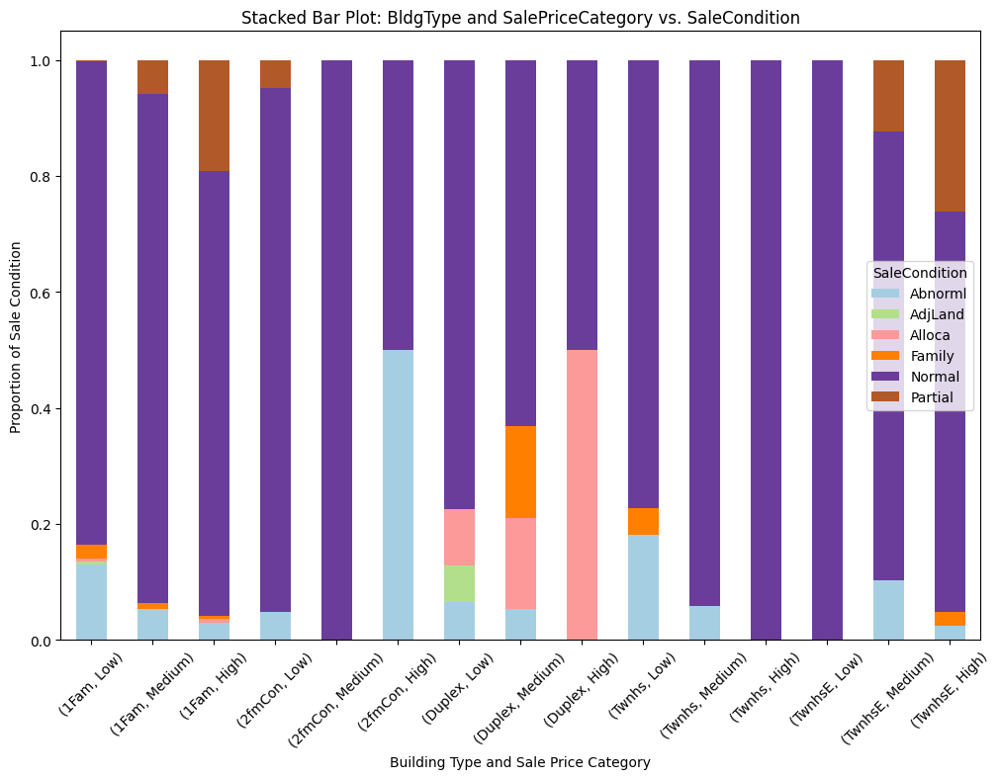

In [784]:
# Categorize SalePrice into bins (e.g., Low, Medium, High)
house['SalePriceCategory'] = pd.qcut(house['SalePrice'], q=3, labels=['Low', 'Medium', 'High'])

# Create a stacked bar plot
cross_tab = pd.crosstab([house['BldgType'], house['SalePriceCategory']], house['SaleCondition'])
cross_tab_normalized = cross_tab.div(cross_tab.sum(1), axis=0)  # Normalize to percentage

cross_tab_normalized.plot(kind='bar', stacked=True, figsize=(12, 8), colormap='Paired')
plt.title('Stacked Bar Plot: BldgType and SalePriceCategory vs. SaleCondition')
plt.xlabel('Building Type and Sale Price Category')
plt.ylabel('Proportion of Sale Condition')
plt.xticks(rotation=45)
plt.show()

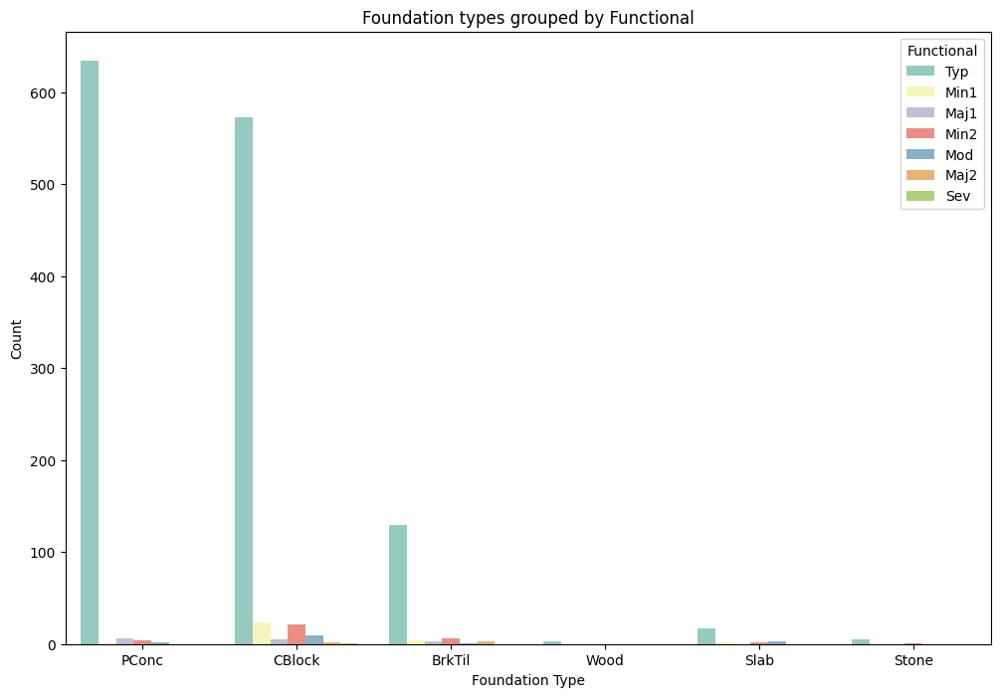

In [785]:
# Grouped Count Plot
plt.figure(figsize=(12, 8))
sns.countplot(data=house, x='Foundation', hue='Functional', palette='Set3')
plt.title('Foundation types grouped by Functional')
plt.xlabel('Foundation Type')
plt.ylabel('Count')
plt.legend(title='Functional')
plt.show()

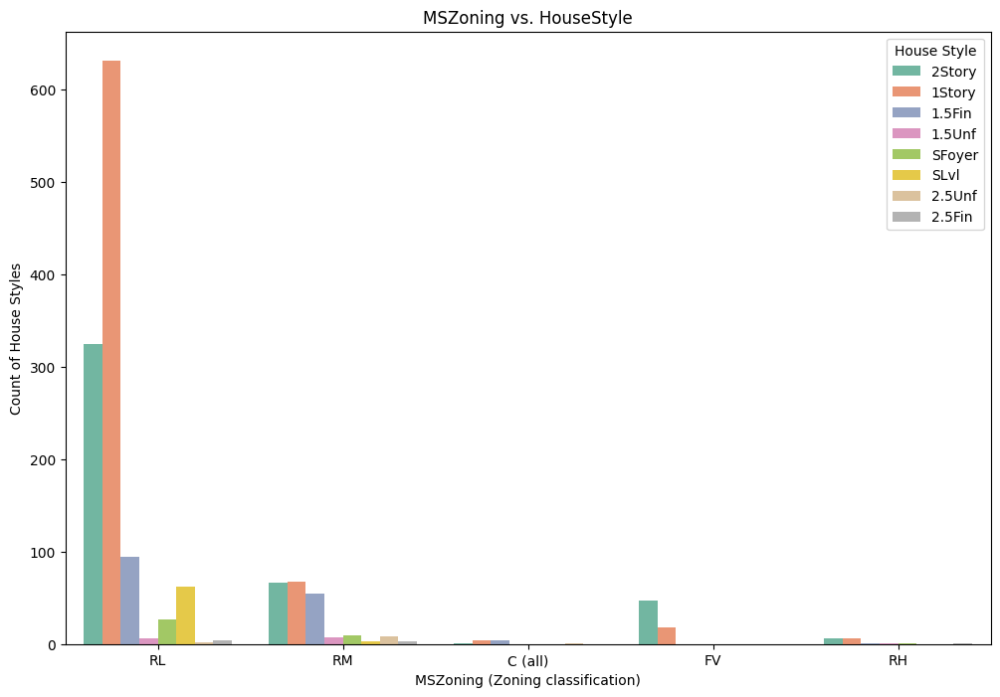

In [786]:
# Side-by-Side Bar Plot: MSZoning vs. HouseStyle
plt.figure(figsize=(12, 8))
sns.countplot(data=house, x='MSZoning', hue='HouseStyle', palette='Set2')
plt.title('MSZoning vs. HouseStyle')
plt.xlabel('MSZoning (Zoning classification)')
plt.ylabel('Count of House Styles')
plt.legend(title='House Style', loc='upper right')
plt.show()

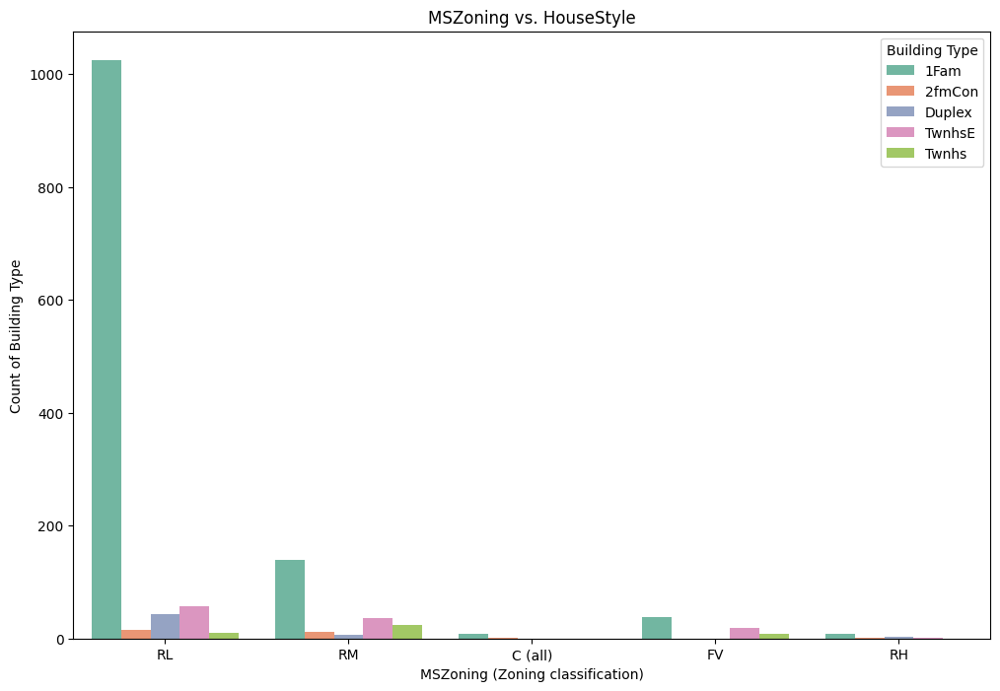

In [787]:
# Side-by-Side Bar Plot: MSZoning vs. HouseStyle
plt.figure(figsize=(12, 8))
sns.countplot(data=house, x='MSZoning', hue='BldgType', palette='Set2')
plt.title('MSZoning vs. HouseStyle')
plt.xlabel('MSZoning (Zoning classification)')
plt.ylabel('Count of Building Type')
plt.legend(title='Building Type', loc='upper right')
plt.show()

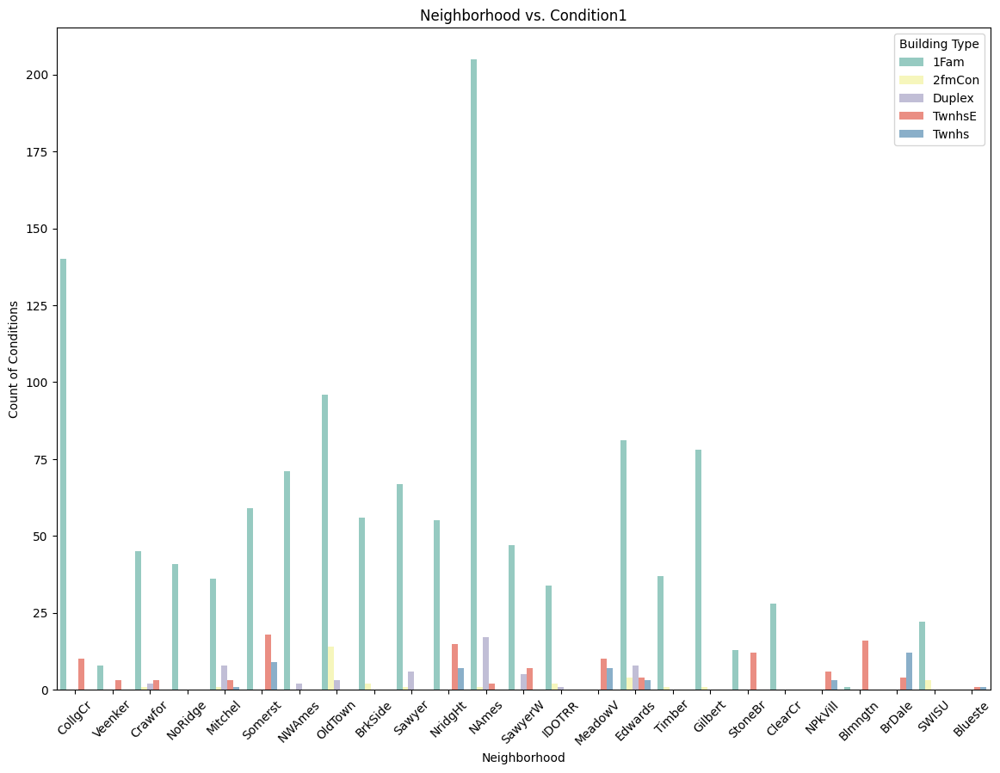

In [788]:
# Side-by-Side Bar Plot: Neighborhood vs. Condition1
plt.figure(figsize=(14, 10))
sns.countplot(data=house, x='Neighborhood', hue='BldgType', palette='Set3')
plt.title('Neighborhood vs. Condition1')
plt.xlabel('Neighborhood')
plt.ylabel('Count of Conditions')
plt.xticks(rotation=45)
plt.legend(title='Building Type', loc='upper right')
plt.show()

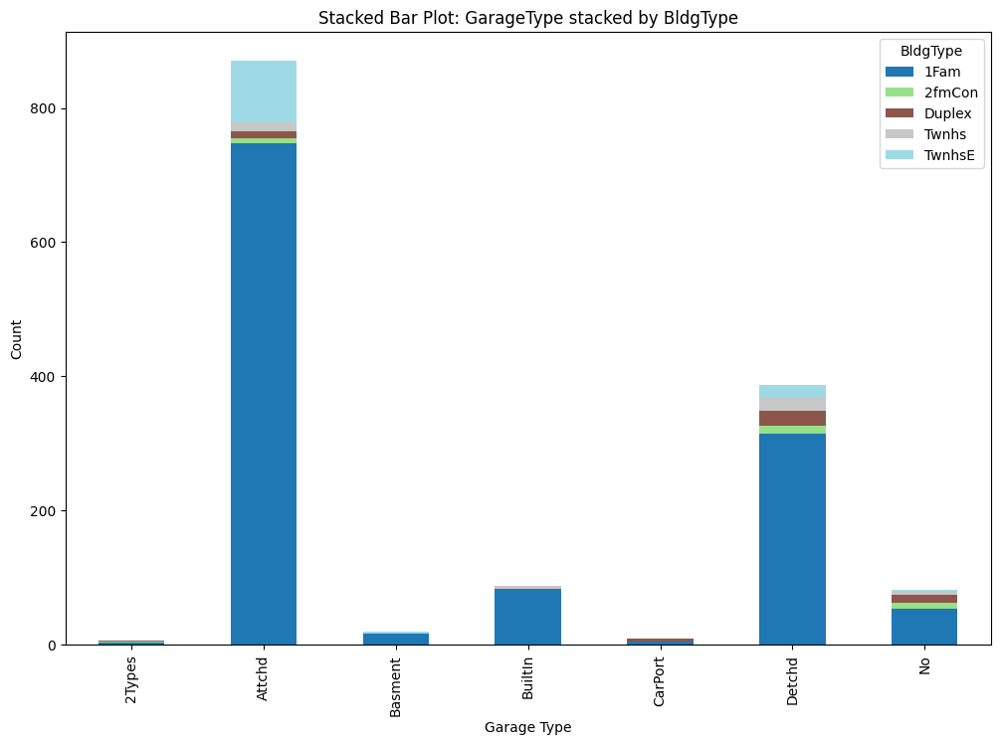

In [789]:
# Cross-tabulation for GarageType and BldgType
cross_tab = pd.crosstab(house['GarageType'], house['BldgType'])

# Stacked Bar Plot
cross_tab.plot(kind='bar', stacked=True, figsize=(12, 8), colormap='tab20')
plt.title('Stacked Bar Plot: GarageType stacked by BldgType')
plt.xlabel('Garage Type')
plt.ylabel('Count')
plt.show()

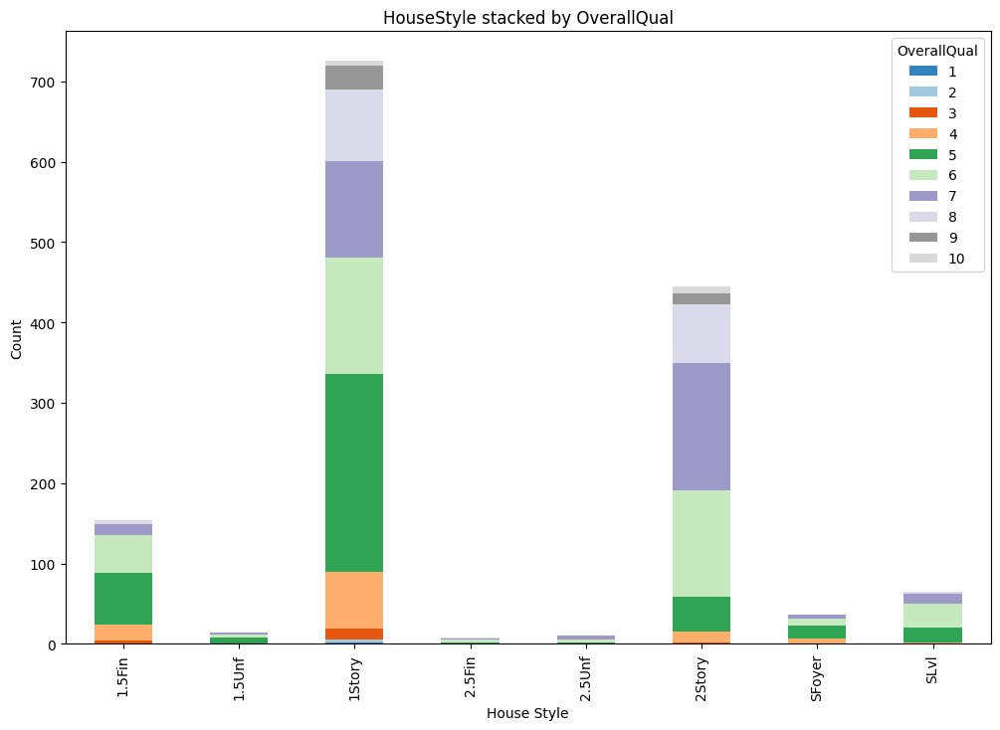

In [790]:
# Cross-tabulation for HouseStyle and OverallQual
cross_tab = pd.crosstab(house['HouseStyle'], house['OverallQual'])

# Stacked Bar Plot
cross_tab.plot(kind='bar', stacked=True, figsize=(12, 8), colormap='tab20c')
plt.title('HouseStyle stacked by OverallQual')
plt.xlabel('House Style')
plt.ylabel('Count')
plt.show()

In [791]:
# # Create a cross-tabulation of BldgType and SaleCondition
# cross_tab = pd.crosstab(house['BldgType'], house['SaleCondition'])

# plt.figure(figsize=(10, 6))
# sns.heatmap(cross_tab, annot=True, cmap='Blues', fmt='d')

# # Add labels and title
# plt.title('Heatmap: BldgType vs. SaleCondition')
# plt.xlabel('SaleCondition')
# plt.ylabel('BldgType')

# plt.show()

In [792]:
# # Boxplot: OverallQual vs. SalePrice
# plt.figure(figsize=(10, 6))
# sns.boxplot(data=house, x='OverallQual', y='SalePrice', palette='Set2')
# plt.title('Boxplot: OverallQual vs. SalePrice')
# plt.xlabel('Overall Quality')
# plt.ylabel('Sale Price')
# plt.show()

In [793]:
# # Boxplot: Neighborhood vs. SalePrice
# plt.figure(figsize=(12, 8))
# sns.boxplot(data=house, x='Neighborhood',hue='Neighborhood', y='SalePrice', palette='Set2', legend=False)
# plt.title('Boxplot: Neighborhood vs. SalePrice')
# plt.xlabel('Neighborhood')
# plt.ylabel('Sale Price')
# plt.xticks(rotation=45)
# plt.show()

In [794]:
# # Violin Plot: OverallQual vs. SalePrice
# plt.figure(figsize=(10, 6))
# sns.violinplot(data=house, x='OverallQual', y='SalePrice', palette='Set3')
# plt.title('Violin Plot: OverallQual vs. SalePrice')
# plt.xlabel('Overall Quality')
# plt.ylabel('Sale Price')
# plt.show()

In [795]:
# # Violin Plot: Neighborhood vs. SalePrice
# plt.figure(figsize=(12, 8))
# sns.violinplot(data=house, x='Neighborhood', y='SalePrice', palette='Set3')
# plt.title('Violin Plot: Neighborhood vs. SalePrice')
# plt.xlabel('Neighborhood')
# plt.ylabel('Sale Price')
# plt.xticks(rotation=45)
# plt.show()

In [796]:
# # Swarmplot: OverallQual vs. SalePrice
# plt.figure(figsize=(10, 6))
# sns.boxplot(data=house, x='OverallQual', y='SalePrice', palette='Set2')
# sns.stripplot(data=house, x='OverallQual', y='SalePrice', color='black', size=3) # or swarmplot
# plt.title('Boxplot with Swarmplot: OverallQual vs. SalePrice')
# plt.xlabel('Overall Quality')
# plt.ylabel('Sale Price')
# plt.show()

In [797]:
# # Swarmplot: Neighborhood vs. SalePrice
# plt.figure(figsize=(12, 8))
# sns.boxplot(data=house, x='Neighborhood', y='SalePrice', palette='Set2')
# sns.stripplot(data=house, x='Neighborhood', y='SalePrice', color='black', size=3)
# plt.title('Boxplot with Swarmplot: Neighborhood vs. SalePrice')
# plt.xlabel('Neighborhood')
# plt.ylabel('Sale Price')
# plt.xticks(rotation=45)
# plt.show()

In [798]:
# # Cross-tabulation for Neighborhood and MSZoning
# cross_tab = pd.crosstab(house['Neighborhood'], house['MSZoning'])

# # Heatmap
# plt.figure(figsize=(12, 8))
# sns.heatmap(cross_tab, annot=True, cmap='coolwarm', fmt='d')
# plt.title('Heatmap: Neighborhood vs. MSZoning')
# plt.xlabel('MSZoning')
# plt.ylabel('Neighborhood')
# plt.xticks(rotation=45)
# plt.show()

In [799]:
# # Sunburst Plot
# fig = px.sunburst(house, path=['Neighborhood', 'MSZoning', 'HouseStyle'], 
#                   title='Sunburst Plot: Neighborhood > MSZoning > HouseStyle')
# fig.show()

In [800]:
# fig = px.parallel_categories(house, dimensions=['Neighborhood', 'MSZoning', 'BldgType','HouseStyle'],
#                              title='Parallel Categories Plot: Neighborhood, MSZoning, and BldgType')

# fig.update_layout(height=1000, width=1100)
# fig.show()

In [801]:
# # Clustered Bar Plot
# plt.figure(figsize=(12, 8))
# sns.countplot(data=house, x='MSZoning', hue='OverallQual', palette='viridis')
# plt.title('Clustered Bar Plot: RoofStyle clustered by OverallQual')
# plt.xlabel('Roof Style')
# plt.ylabel('Count')
# plt.legend(title='Overall Quality')
# plt.show()

## Linear Regression Model

In [940]:
house_cleaned.head()

,MSZoning,LotFrontage,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,GrLivArea,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,PoolQC,Fence,MiscFeature,SaleType,SaleCondition,SalePrice,YearBuilt_Binned,SalePriceCategory,HomeAge,RemodAge,TotalBathrooms,SalePrice_log
0,RL,65.0,Pave,No,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,856,GasA,Ex,Y,SBrkr,856,1710,Gd,8,Typ,0,No,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,No,No,No,WD,Normal,208500,2000+,High,5,5,2.5,5.319106
1,RL,80.0,Pave,No,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,Gable,CompShg,MetalSd,MetalSd,No,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,1262,GasA,Ex,Y,SBrkr,1262,1262,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,No,No,No,WD,Normal,181500,1960-1980,Medium,31,31,2.0,5.258877
2,RL,68.0,Pave,No,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,920,GasA,Ex,Y,SBrkr,920,1786,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,No,No,No,WD,Normal,223500,2000+,High,7,6,2.5,5.349278
3,RL,60.0,Pave,No,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,Gable,CompShg,Wd Sdng,Wd Shng,No,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,756,GasA,Gd,Y,SBrkr,961,1717,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,No,No,No,WD,Abnorml,140000,1900-1920,Medium,91,36,1.0,5.146128
4,RL,84.0,Pave,No,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,1145,GasA,Ex,Y,SBrkr,1145,2198,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,No,No,No,WD,Normal,250000,1980-2000,High,8,8,2.5,5.397940


In [999]:
data = house_cleaned.copy()

In [1039]:
data = house_cleaned[["OverallQual","GrLivArea", "GarageCars", "HomeAge",
                        "RemodAge", "TotalBsmtSF" ,"SalePrice", "SalePrice_log","LotFrontage"]]
                     # 'Foundation', 'Fireplaces', 'GarageFinish', 'GarageType']]

In [1040]:
data.head()

,OverallQual,GrLivArea,GarageCars,HomeAge,RemodAge,TotalBsmtSF,SalePrice,SalePrice_log,LotFrontage
0,7,1710,2,5,5,856,208500,5.319106,65.0
1,6,1262,2,31,31,1262,181500,5.258877,80.0
2,7,1786,2,7,6,920,223500,5.349278,68.0
3,7,1717,3,91,36,756,140000,5.146128,60.0
4,8,2198,3,8,8,1145,250000,5.397940,84.0


In [1041]:
X = data.drop(columns=["SalePrice", "SalePrice_log"])
y = data[["SalePrice_log"]]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### ِEncoding

In [1003]:
le_street = LabelEncoder()
le_alley = LabelEncoder()
le_zone = LabelEncoder()

X_train["Street"] = le_street.fit_transform(X_train["Street"])
X_train["Alley"] = le_alley.fit_transform(X_train["Alley"])
X_train["MSZoning"] = le_zone.fit_transform(X_train["MSZoning"])

In [1004]:
le_shape = LabelEncoder()
le_config = LabelEncoder()
le_contour = LabelEncoder()
le_slope = LabelEncoder()

X_train["LotShape"] = le_shape.fit_transform(X_train["LotShape"])
X_train["LotConfig"] = le_config.fit_transform(X_train["LotConfig"])
X_train["LandContour"] = le_contour.fit_transform(X_train["LandContour"])
X_train["LandSlope"] = le_slope.fit_transform(X_train["LandSlope"])

In [1005]:
le_util = LabelEncoder()
le_neigh = LabelEncoder()
le_cond1 = LabelEncoder()
le_cond2 = LabelEncoder()

X_train["Utilities"] = le_util.fit_transform(X_train["Utilities"])
X_train["Neighborhood"] = le_neigh.fit_transform(X_train["Neighborhood"])
X_train["Condition1"] = le_cond1.fit_transform(X_train["Condition1"])
X_train["Condition2"] = le_cond2.fit_transform(X_train["Condition2"])

In [1006]:
le_build = LabelEncoder()
le_house = LabelEncoder()
le_found = LabelEncoder()

X_train["BldgType"] = le_build.fit_transform(X_train["BldgType"])
X_train["HouseStyle"] = le_house.fit_transform(X_train["HouseStyle"])
X_train["Foundation"] = le_found.fit_transform(X_train["Foundation"])

In [1007]:
le_roofstyle = LabelEncoder()
le_roofmat = LabelEncoder()

X_train["RoofStyle"] = le_roofstyle.fit_transform(X_train["RoofStyle"])
X_train["RoofMatl"] = le_roofmat.fit_transform(X_train["RoofMatl"])

In [1008]:
le_ext1 = LabelEncoder()
le_ext2 = LabelEncoder()
oe_extqual = OrdinalEncoder(categories=[['Po','Fa', 'TA', 'Gd', 'Ex']])
oe_extcond = OrdinalEncoder(categories=[['Po', 'Fa', 'TA', 'Gd', 'Ex']])
le_masvnr = LabelEncoder()

X_train["Exterior1st"] = le_ext1.fit_transform(X_train["Exterior1st"])
X_train["Exterior2nd"] = le_ext2.fit_transform(X_train["Exterior2nd"])
X_train["ExterQual"] = oe_extqual.fit_transform(X_train[["ExterQual"]])
X_train["ExterCond"] = oe_extcond.fit_transform(X_train[["ExterCond"]])
X_train["MasVnrType"] = le_masvnr.fit_transform(X_train["MasVnrType"])

In [1009]:
le_bsmt1 = LabelEncoder()
le_bsmt2 = LabelEncoder()
oe_bsmtqual = OrdinalEncoder(categories=[['No Basment','Po','Fa', 'TA', 'Gd', 'Ex']])
oe_bsmtcond = OrdinalEncoder(categories=[['No Basment','Po', 'Fa', 'TA', 'Gd', 'Ex']])
oe_bsmtexp = OrdinalEncoder(categories=[['No Basment', 'No', 'Mn', 'Av', 'Gd']])

X_train["BsmtFinType1"] = le_bsmt1.fit_transform(X_train["BsmtFinType1"])
X_train["BsmtFinType2"] = le_bsmt2.fit_transform(X_train["BsmtFinType2"])
X_train["BsmtQual"] = oe_bsmtqual.fit_transform(X_train[["BsmtQual"]])
X_train["BsmtCond"] = oe_bsmtcond.fit_transform(X_train[["BsmtCond"]])
X_train["BsmtExposure"] = oe_bsmtexp.fit_transform(X_train[["BsmtExposure"]])

In [1010]:
le_elec = LabelEncoder()
le_heat = LabelEncoder()
le_centrair = LabelEncoder()
le_func = LabelEncoder()
oe_heatqual = OrdinalEncoder(categories=[['Po','Fa', 'TA', 'Gd', 'Ex']])
oe_kitchqu = OrdinalEncoder(categories=[['Po', 'Fa', 'TA', 'Gd', 'Ex']])
oe_firequ = OrdinalEncoder(categories=[['No', 'Po','Fa', 'TA', 'Gd','Ex']])

X_train["Electrical"] = le_elec.fit_transform(X_train["Electrical"])
X_train["Heating"] = le_heat.fit_transform(X_train["Heating"])
X_train["CentralAir"] = le_centrair.fit_transform(X_train["CentralAir"])
X_train["Functional"] = le_func.fit_transform(X_train["Functional"])
X_train["HeatingQC"] = oe_heatqual.fit_transform(X_train[["HeatingQC"]])
X_train["KitchenQual"] = oe_kitchqu.fit_transform(X_train[["KitchenQual"]])
X_train["FireplaceQu"] = oe_firequ.fit_transform(X_train[["FireplaceQu"]])

In [1011]:
le_gartype = LabelEncoder()
le_garfinish = LabelEncoder()
oe_garqual = OrdinalEncoder(categories=[['No','Po','Fa', 'TA', 'Gd', 'Ex']])
oe_garcond = OrdinalEncoder(categories=[['No','Po', 'Fa', 'TA', 'Gd', 'Ex']])

X_train["GarageType"] = le_gartype.fit_transform(X_train["GarageType"])
X_train["GarageFinish"] = le_garfinish.fit_transform(X_train["GarageFinish"])
X_train["GarageQual"] = oe_garqual.fit_transform(X_train[["GarageQual"]])
X_train["GarageCond"] = oe_garcond.fit_transform(X_train[["GarageCond"]])

In [1012]:
le_saleype = LabelEncoder()
le_salecond = LabelEncoder()

X_train["SaleType"] = le_saleype.fit_transform(X_train["SaleType"])
X_train["SaleCondition"] = le_salecond.fit_transform(X_train["SaleCondition"])

In [1013]:
dropped_Cat = X_train.select_dtypes(include=["object","category"])
dropped_Cat.columns

Index(['PavedDrive', 'PoolQC', 'Fence', 'MiscFeature', 'YearBuilt_Binned',
       'SalePriceCategory'],
      dtype='object')

In [1014]:
X_train = X_train.drop(columns=['PavedDrive', 'PoolQC', 'Fence', 'MiscFeature', 'YearBuilt_Binned',
       'SalePriceCategory'])

In [1015]:
X_test = X_test.drop(columns=['PavedDrive', 'PoolQC', 'Fence', 'MiscFeature', 'YearBuilt_Binned',
       'SalePriceCategory'])

In [998]:
sc_area = RobustScaler()
X_train["GrLivArea"] = sc_area.fit_transform(X_train[["GrLivArea"]])

In [ ]:
sc_bsmtot = RobustScaler()
X_train["TotalBsmtSF"] = sc_bsmtot.fit_transform(X_train[["TotalBsmtSF"]])

In [880]:
X_train

,MSZoning,LotFrontage,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,GrLivArea,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,WoodDeckSF,OpenPorchSF,SaleType,SaleCondition,HomeAge,RemodAge,TotalBathrooms
254,3,70.0,1,1,3,3,0,4,0,12,2,2,0,2,5,1,1,8,8,2,0.0,2.0,3.0,1,3.0,3.0,1.0,5,6,1314,1,2.0,1,3,1314,1314,2.0,5,6,0,0.0,1,1957.0,2,1,294,3.0,3.0,250,0,8,4,53,53,1.0
1066,3,59.0,1,1,0,3,0,4,0,8,2,2,0,5,6,1,1,12,13,2,0.0,3.0,2.0,2,4.0,3.0,1.0,6,6,799,1,3.0,1,3,799,1571,2.0,7,6,1,3.0,1,1993.0,2,2,380,3.0,3.0,0,40,8,4,16,15,2.5
638,3,67.0,1,1,3,3,0,4,0,7,1,2,0,2,5,1,1,8,14,2,0.0,2.0,2.0,1,2.0,3.0,1.0,6,6,796,1,3.0,1,0,796,796,2.0,4,6,0,0.0,6,0.0,1,0,0,0.0,0.0,328,0,8,4,98,58,1.0
799,3,60.0,1,1,3,3,0,0,0,18,1,2,0,0,5,1,1,13,14,1,252.0,2.0,2.0,0,4.0,3.0,1.0,0,6,731,1,4.0,1,3,981,1768,3.0,7,6,2,3.0,5,1939.0,3,1,240,3.0,3.0,0,0,8,4,70,57,1.5
380,3,50.0,1,2,3,3,0,4,0,18,2,2,0,0,5,1,1,3,14,2,0.0,2.0,2.0,0,3.0,3.0,1.0,3,6,1026,1,2.0,1,3,1026,1691,3.0,6,6,1,4.0,5,1924.0,3,1,308,3.0,3.0,0,0,8,4,86,60,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1095,3,78.0,1,1,0,3,0,4,0,5,2,2,0,2,6,1,1,12,13,2,0.0,3.0,2.0,2,4.0,3.0,1.0,2,6,1314,1,3.0,1,3,1314,1314,3.0,6,6,1,4.0,1,2006.0,2,2,440,3.0,3.0,0,22,8,4,1,1,2.0
1130,3,65.0,1,1,3,3,0,4,0,18,2,2,0,0,4,1,1,14,10,2,0.0,2.0,2.0,0,3.0,3.0,1.0,1,6,1122,1,2.0,1,3,1328,1981,3.0,7,3,2,3.0,5,1981.0,3,2,576,3.0,3.0,431,44,8,4,81,59,2.0
1294,3,60.0,1,1,3,3,0,4,0,7,2,2,0,2,5,3,1,14,10,2,0.0,2.0,2.0,1,3.0,3.0,1.0,5,6,864,1,2.0,1,3,864,864,2.0,5,6,0,0.0,5,1957.0,3,2,572,3.0,3.0,0,0,8,4,51,16,1.0
860,3,55.0,1,1,3,3,0,0,0,6,2,2,0,0,7,1,1,13,14,2,0.0,3.0,2.0,0,3.0,3.0,1.0,6,6,912,1,3.0,1,3,912,1426,3.0,7,6,1,4.0,5,1925.0,3,1,216,3.0,3.0,0,240,8,4,89,9,1.5


In [979]:
# # Combine DataFrames
# combined_df = pd.concat([X_train, y_train], axis=1)

# # Compute correlation matrix
# correlation_matrix = combined_df.corr()

# # Create a heatmap
# plt.figure(figsize=(25, 25))
# sns.heatmap(correlation_matrix, annot=True, fmt='.1f', linewidths=0.5)
# plt.title('Heatmap of Feature Correlations with Target')
# plt.tight_layout()
# plt.show()

In [ ]:
X_test["GrLivArea"] = sc_area.transform(X_test[["GrLivArea"]])
X_test["TotalBsmtSF"] = sc_bsmtot.transform(X_test[["TotalBsmtSF"]])

In [ ]:
y

In [1042]:
print("The Shape of X_train is :",X_train.shape)
print("The Shape of y_train is :",y_train.shape)
print("The Shape of X_test is :",X_test.shape)
print("The Shape of y_test is :",y_test.shape)

The Shape of X_train is : (1168, 7)
The Shape of y_train is : (1168, 1)
The Shape of X_test is : (292, 7)
The Shape of y_test is : (292, 1)


In [ ]:
X_test["Street"] = le_street.transform(X_test["Street"])
X_test["Alley"] = le_alley.transform(X_test["Alley"])
X_test["MSZoning"] = le_zone.transform(X_test["MSZoning"])
X_test["LotShape"] = le_shape.transform(X_test["LotShape"])
X_test["LotConfig"] = le_config.transform(X_test["LotConfig"])
X_test["LandContour"] = le_contour.transform(X_test["LandContour"])
X_test["LandSlope"] = le_slope.transform(X_test["LandSlope"])
X_test["Utilities"] = le_util.transform(X_test["Utilities"])
X_test["Neighborhood"] = le_neigh.transform(X_test["Neighborhood"])
X_test["Condition1"] = le_cond1.transform(X_test["Condition1"])
X_test["Condition2"] = le_cond2.transform(X_test["Condition2"])
X_test["BldgType"] = le_build.transform(X_test["BldgType"])
X_test["HouseStyle"] = le_house.transform(X_test["HouseStyle"])
X_test["Foundation"] = le_found.transform(X_test["Foundation"])
X_test["RoofStyle"] = le_roofstyle.transform(X_test["RoofStyle"])
X_test["RoofMatl"] = le_roofmat.transform(X_test["RoofMatl"])
X_test["Exterior1st"] = le_ext1.transform(X_test["Exterior1st"])
X_test["Exterior2nd"] = le_ext2.transform(X_test["Exterior2nd"])
X_test["ExterQual"] = oe_extqual.transform(X_test[["ExterQual"]])
X_test["ExterCond"] = oe_extcond.transform(X_test[["ExterCond"]])
X_test["MasVnrType"] = le_masvnr.transform(X_test["MasVnrType"])
X_test["BsmtFinType1"] = le_bsmt1.transform(X_test["BsmtFinType1"])
X_test["BsmtFinType2"] = le_bsmt2.transform(X_test["BsmtFinType2"])
X_test["BsmtQual"] = oe_bsmtqual.transform(X_test[["BsmtQual"]])
X_test["BsmtCond"] = oe_bsmtcond.transform(X_test[["BsmtCond"]])
X_test["BsmtExposure"] = oe_bsmtexp.transform(X_test[["BsmtExposure"]])
X_test["Electrical"] = le_elec.transform(X_test["Electrical"])
X_test["Heating"] = le_heat.transform(X_test["Heating"])
X_test["CentralAir"] = le_centrair.transform(X_test["CentralAir"])
X_test["Functional"] = le_func.transform(X_test["Functional"])
X_test["HeatingQC"] = oe_heatqual.transform(X_test[["HeatingQC"]])
X_test["KitchenQual"] = oe_kitchqu.transform(X_test[["KitchenQual"]])
X_test["FireplaceQu"] = oe_firequ.transform(X_test[["FireplaceQu"]])
X_test["GarageType"] = le_gartype.transform(X_test["GarageType"])
X_test["GarageFinish"] = le_garfinish.transform(X_test["GarageFinish"])
X_test["GarageQual"] = oe_garqual.transform(X_test[["GarageQual"]])
X_test["GarageCond"] = oe_garcond.transform(X_test[["GarageCond"]])
X_test["SaleType"] = le_saleype.transform(X_test["SaleType"])
X_test["SaleCondition"] = le_salecond.transform(X_test["SaleCondition"])

In [1043]:
y_test

,SalePrice_log
892,5.188928
1105,5.511883
413,5.060698
522,5.201397
1036,5.498999
...,...
479,4.951682
1361,5.414973
802,5.276462
651,5.033424


In [1044]:
lin_reg = LinearRegression()

lin_reg.fit(X_train, y_train)

y_pred = lin_reg.predict(X_test)

In [1045]:
# y_pred_sale = 10**y_pred
# y_pred_sale

In [1046]:
r2 = r2_score(y_pred, y_test)
r2

0.7891874441522749

In [1047]:
rmse = root_mean_squared_error(y_test, y_pred)
rmse

np.float64(0.07335297475994262)

In [1048]:
from sklearn.preprocessing import PolynomialFeatures


poly = PolynomialFeatures(degree=2)
X_poly_train = poly.fit_transform(X_train)
X_poly_test = poly.transform(X_test)

model = LinearRegression()
model.fit(X_poly_train, y_train)

LinearRegression()

In [1049]:
y_pred = lin_reg.predict(X_test)
r2 = r2_score(y_pred, y_test)
r2

0.7891874441522749

In [1052]:
y_train_pred = lin_reg.predict(X_train)
print("Training Set R^2 Score:", r2_score(y_train, y_train_pred))

Training Set R^2 Score: 0.810429802957463


In [1028]:
y_test

,SalePrice_log
892,5.188928
1105,5.511883
413,5.060698
522,5.201397
1036,5.498999
...,...
479,4.951682
1361,5.414973
802,5.276462
651,5.033424


In [1029]:
y_test["Predictions"] = y_pred

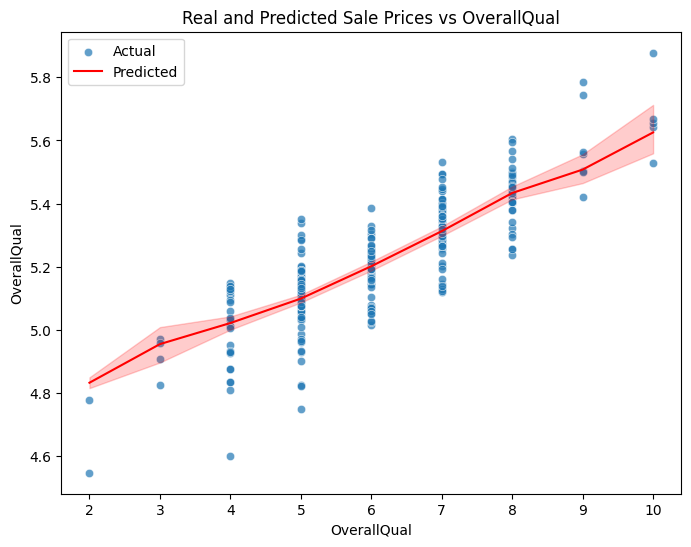

In [1030]:
# Visualizing real and predicted Sale Prices
plt.figure(figsize=(8,6))
sns.scatterplot(x=data['OverallQual'], y=y_test['SalePrice_log'],alpha=0.7, label= 'Actual')
sns.lineplot(x=data['OverallQual'], y=y_test['Predictions'], label='Predicted', color="red")
plt.title('Real and Predicted Sale Prices vs OverallQual')
plt.ylabel('OverallQual')
plt.legend();